# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [2]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [3]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [4]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [5]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels,n_classes)
    #### END CODE HERE ####

In [6]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [7]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(),y.float()), dim=1).type(torch.float)
    #### END CODE HERE ####
    return combined

In [8]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [9]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [10]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [11]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [12]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [13]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.476710395336151, discriminator loss: 0.254248620569706


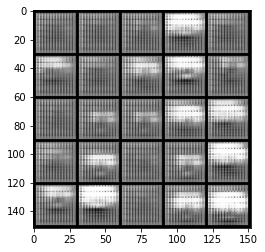

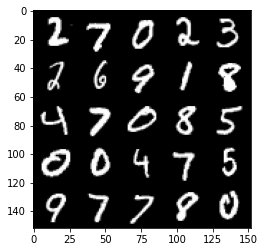

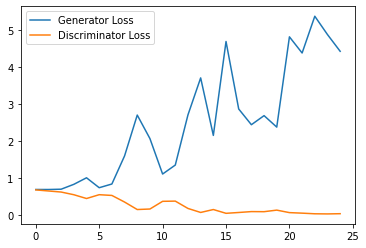

Step 1000: Generator loss: 4.3812525639533995, discriminator loss: 0.049182305613532665


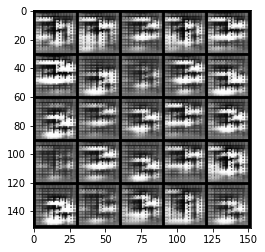

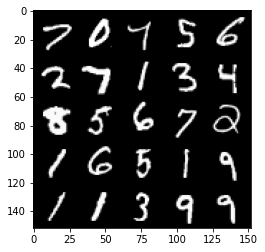

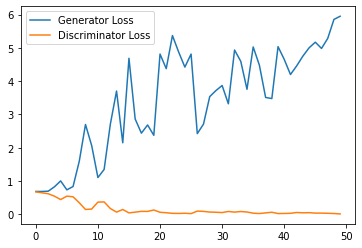

Step 1500: Generator loss: 4.76590642118454, discriminator loss: 0.048648186029866335


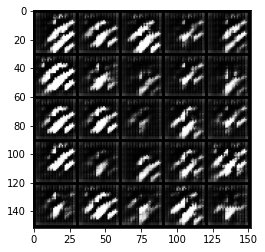

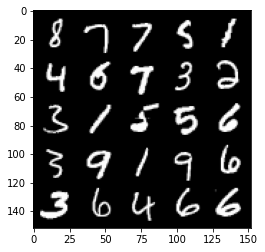

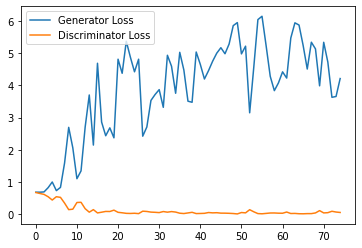

Step 2000: Generator loss: 4.398097099781037, discriminator loss: 0.07480716002732515


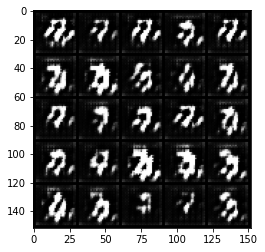

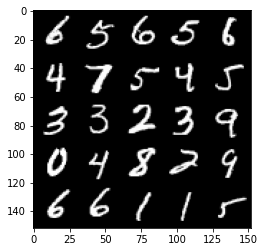

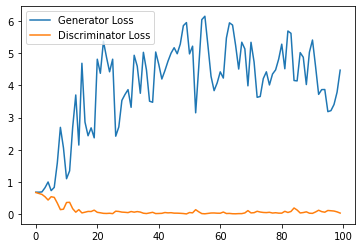

Step 2500: Generator loss: 3.4327609658241274, discriminator loss: 0.1421144688129425


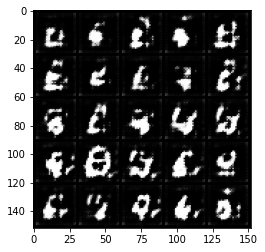

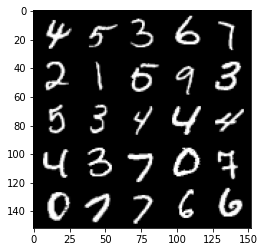

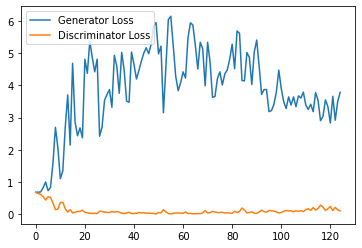

Step 3000: Generator loss: 3.014738833665848, discriminator loss: 0.20430893510580062


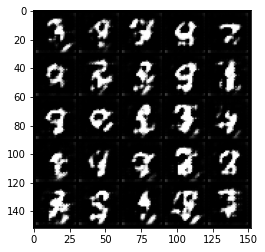

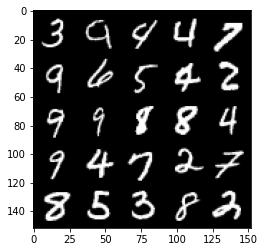

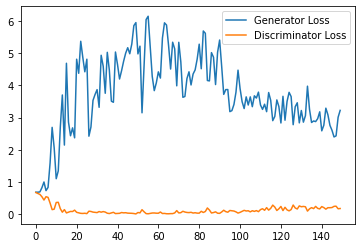

Step 3500: Generator loss: 2.6419415690898895, discriminator loss: 0.2896345320045948


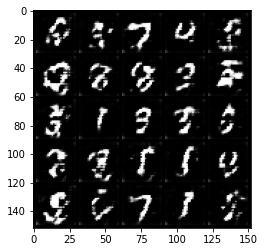

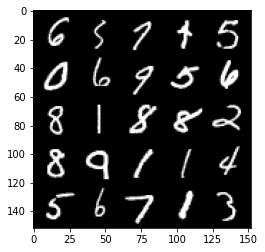

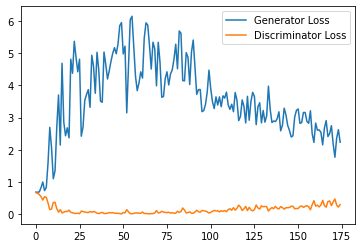

Step 4000: Generator loss: 2.217589511394501, discriminator loss: 0.2906190513074398


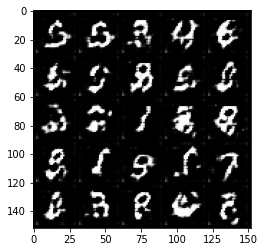

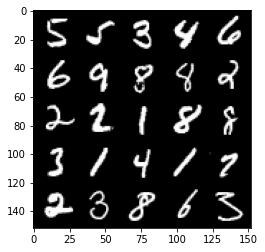

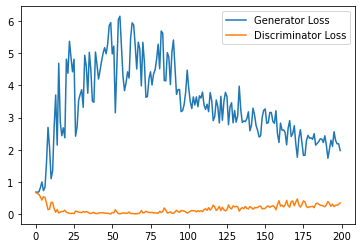

Step 4500: Generator loss: 2.0214336748123167, discriminator loss: 0.3350940460562706


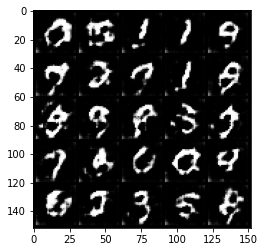

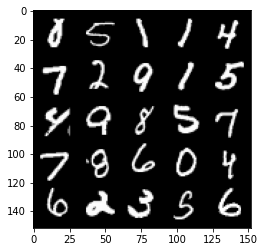

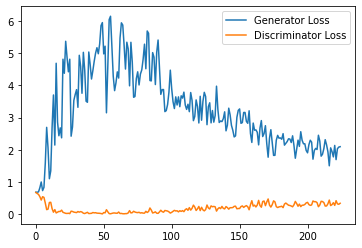

Step 5000: Generator loss: 2.0903679149150847, discriminator loss: 0.33520656257867815


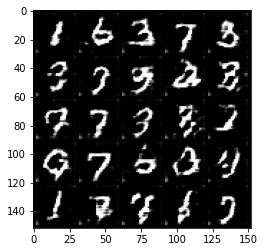

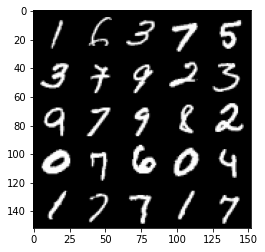

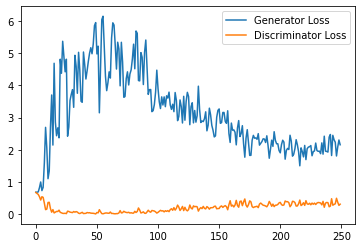

Step 5500: Generator loss: 1.926108426809311, discriminator loss: 0.3557428017854691


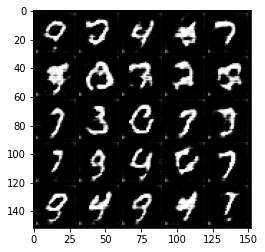

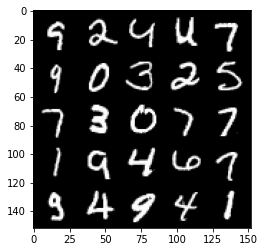

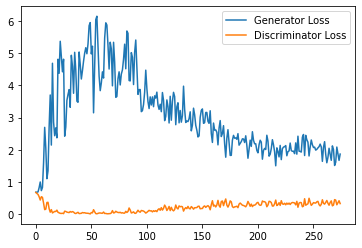

Step 6000: Generator loss: 1.7606418216228485, discriminator loss: 0.3878128181099892


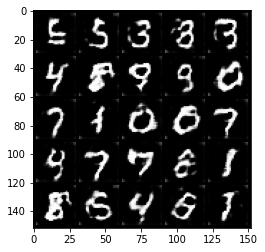

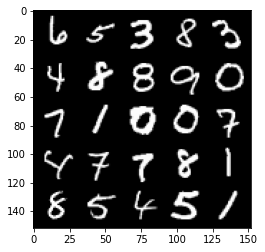

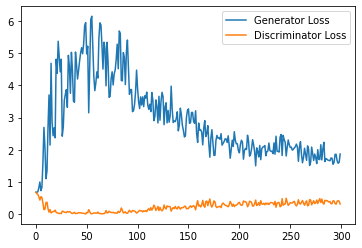

Step 6500: Generator loss: 1.719036034822464, discriminator loss: 0.40733707922697066


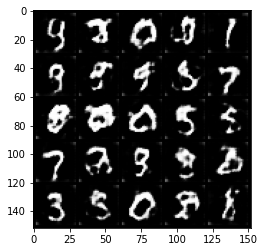

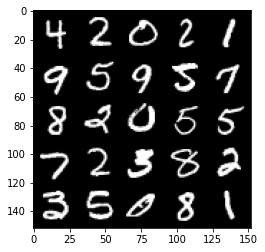

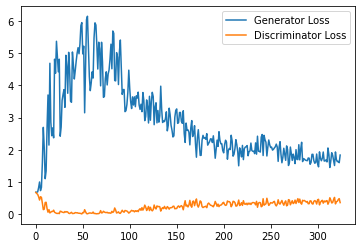

Step 7000: Generator loss: 1.5947067638635635, discriminator loss: 0.4128157149851322


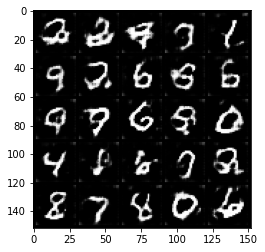

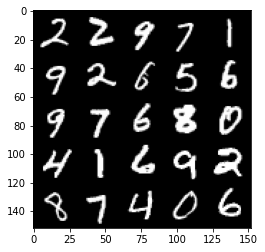

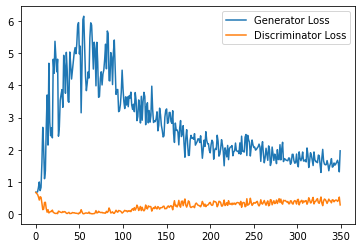

Step 7500: Generator loss: 1.4747975956201553, discriminator loss: 0.452779972076416


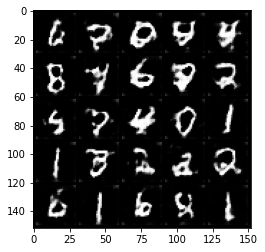

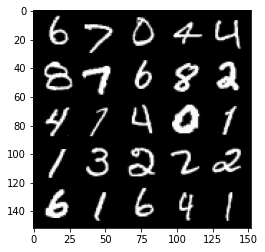

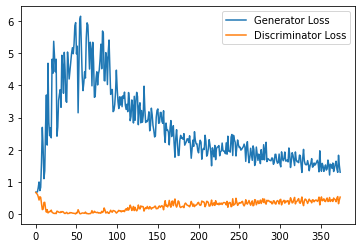

Step 8000: Generator loss: 1.4623231947422028, discriminator loss: 0.4827422997355461


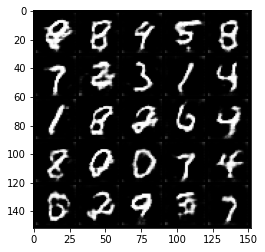

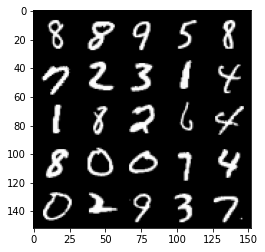

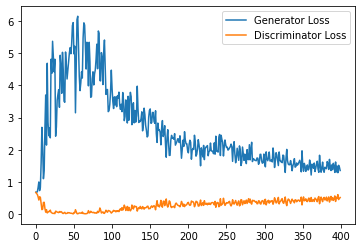

Step 8500: Generator loss: 1.326115760087967, discriminator loss: 0.4963718916773796


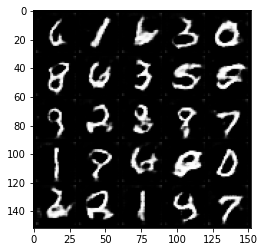

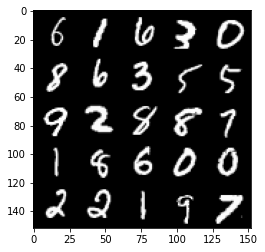

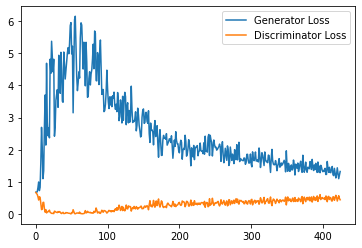

Step 9000: Generator loss: 1.2769440760612487, discriminator loss: 0.5162151322364807


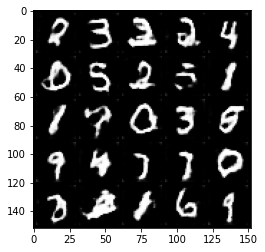

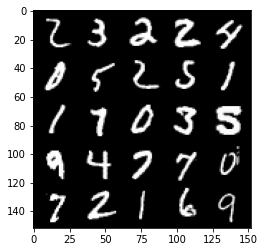

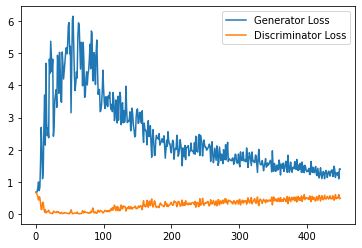

Step 9500: Generator loss: 1.2820510964393617, discriminator loss: 0.5320266320705413


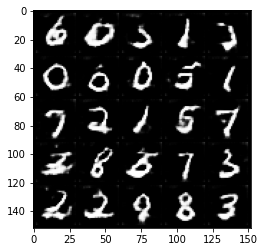

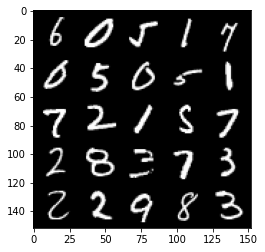

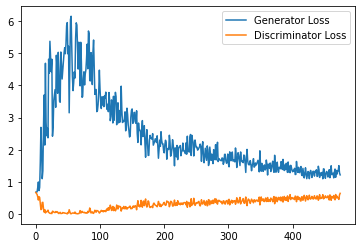

Step 10000: Generator loss: 1.3233988267183303, discriminator loss: 0.5343329858183861


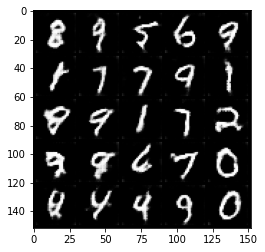

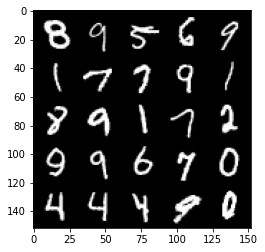

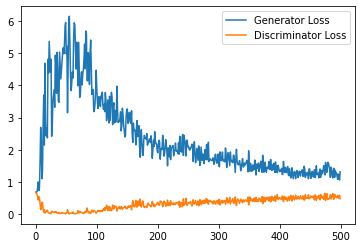

Step 10500: Generator loss: 1.2125058681964875, discriminator loss: 0.5494935554265976


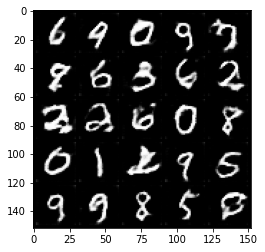

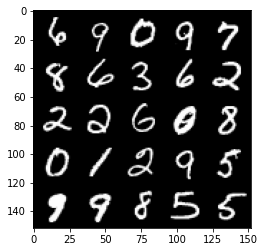

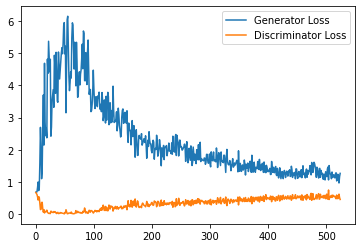

Step 11000: Generator loss: 1.2487014200687407, discriminator loss: 0.5644706481695175


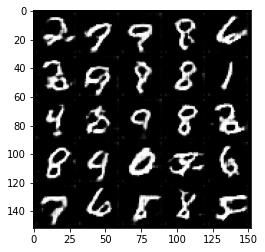

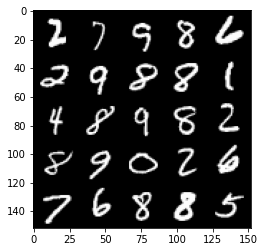

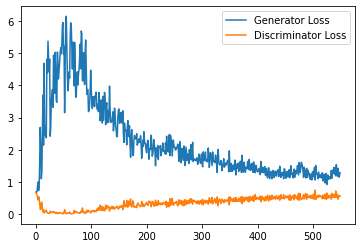

Step 11500: Generator loss: 1.2596856443881987, discriminator loss: 0.5547086225152016


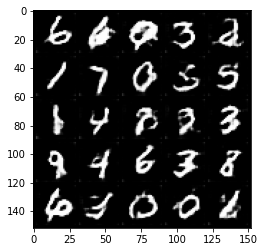

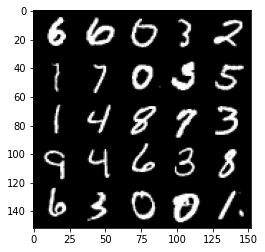

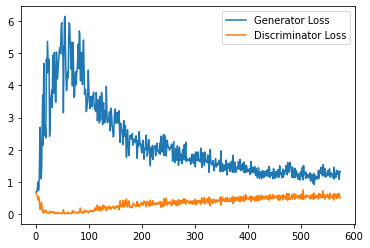

Step 12000: Generator loss: 1.1363644615411759, discriminator loss: 0.579278640627861


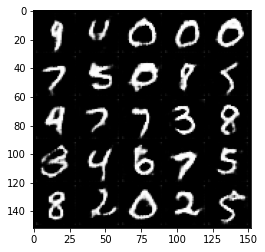

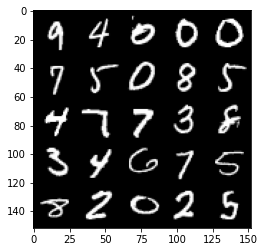

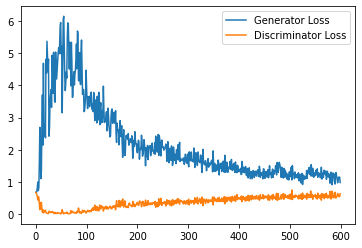

Step 12500: Generator loss: 1.1054250918626785, discriminator loss: 0.566429367363453


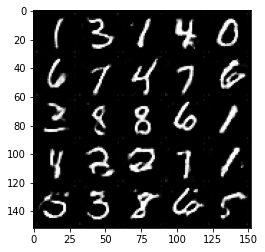

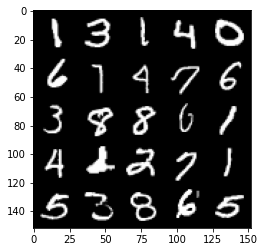

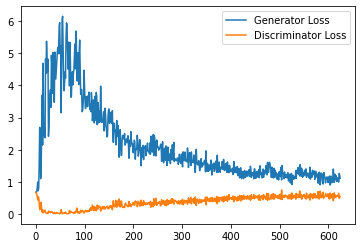

Step 13000: Generator loss: 1.0944160841703414, discriminator loss: 0.5804922849535942


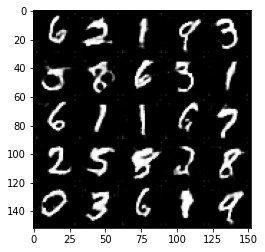

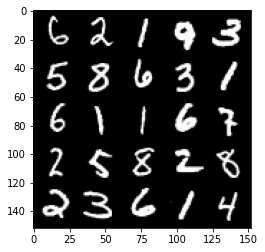

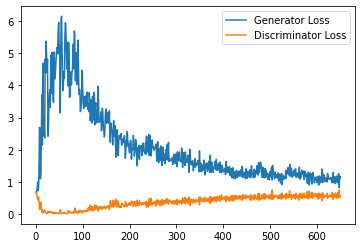

Step 13500: Generator loss: 1.110608330965042, discriminator loss: 0.5764131793379783


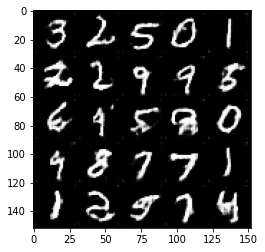

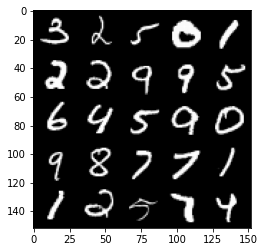

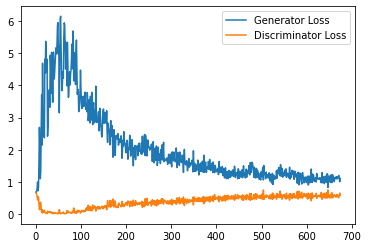

Step 14000: Generator loss: 1.1282366087436677, discriminator loss: 0.5831110176444053


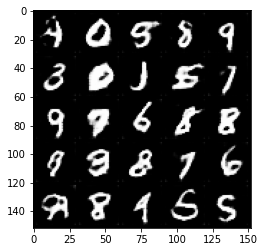

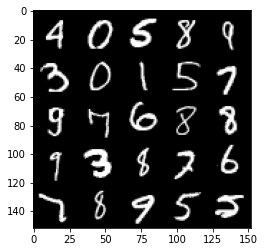

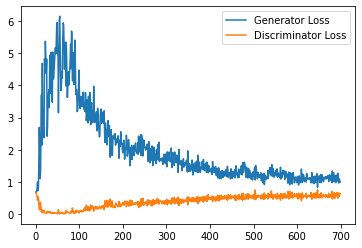

Step 14500: Generator loss: 1.1069450517892838, discriminator loss: 0.5735290672183037


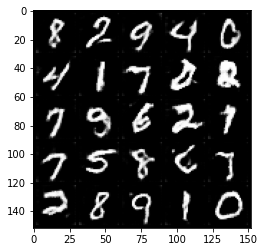

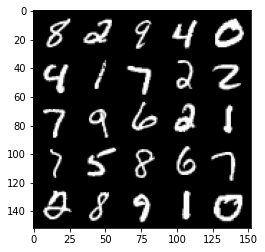

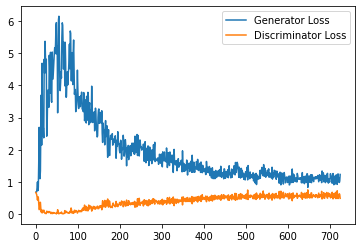

Step 15000: Generator loss: 1.0478711124658584, discriminator loss: 0.5840461379289628


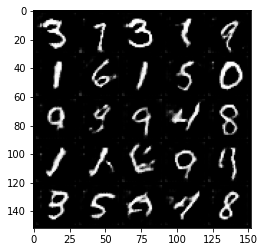

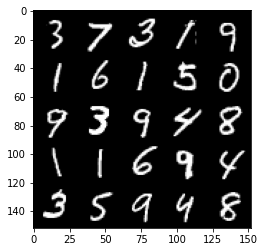

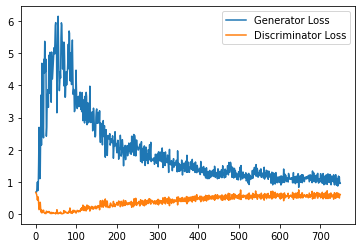

Step 15500: Generator loss: 1.0891392650604248, discriminator loss: 0.5712244884967804


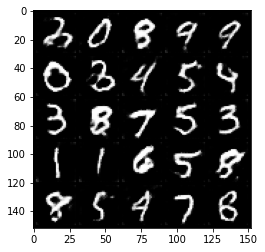

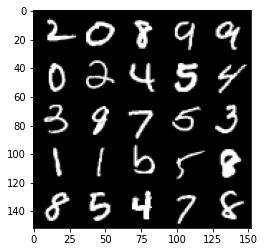

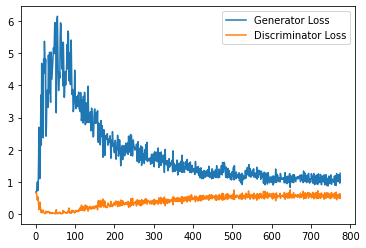

Step 16000: Generator loss: 1.1158078854084015, discriminator loss: 0.5748552058935166


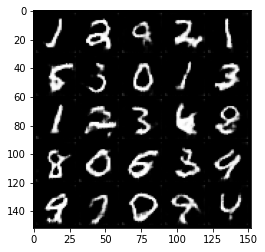

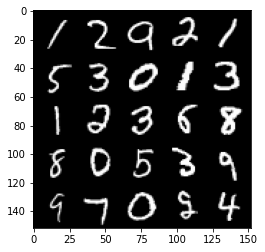

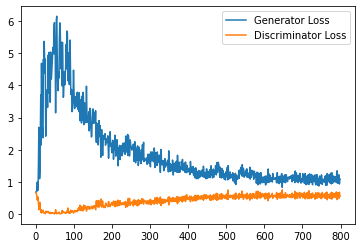

Step 16500: Generator loss: 1.0446525869369507, discriminator loss: 0.5754769361615181


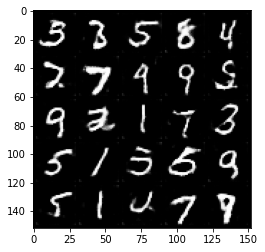

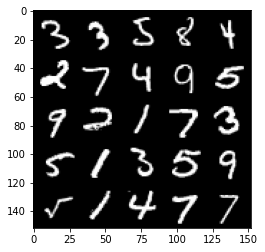

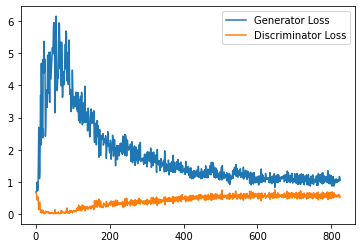

Step 17000: Generator loss: 1.1050064662694932, discriminator loss: 0.5639833405613899


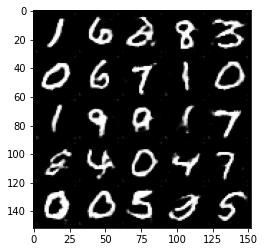

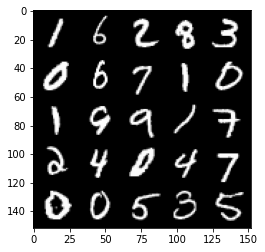

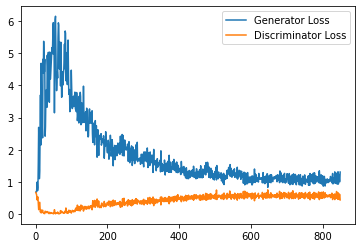

Step 17500: Generator loss: 1.0538452134132386, discriminator loss: 0.5827164189815521


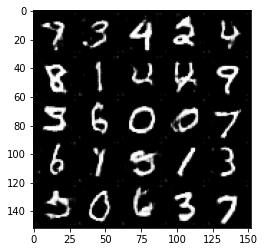

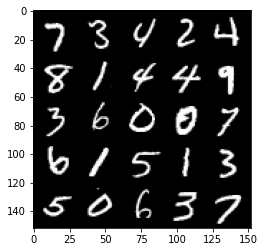

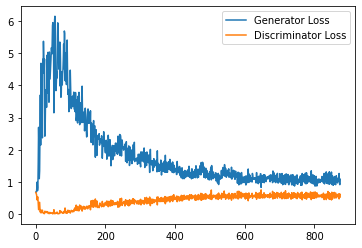

Step 18000: Generator loss: 1.0626225576400756, discriminator loss: 0.5770902152657509


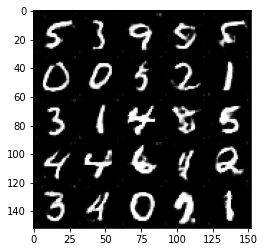

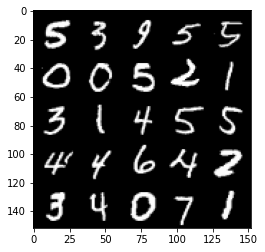

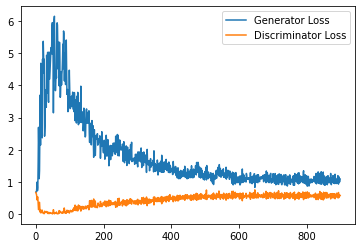

Step 18500: Generator loss: 1.0874025129079818, discriminator loss: 0.5748198436498642


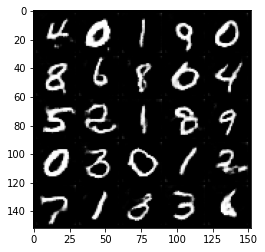

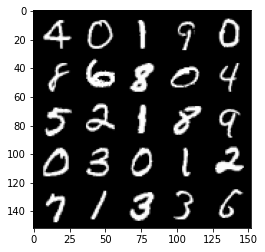

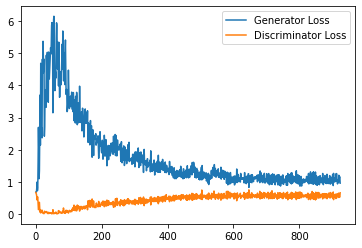

Step 19000: Generator loss: 1.0626533209085465, discriminator loss: 0.5842625411748886


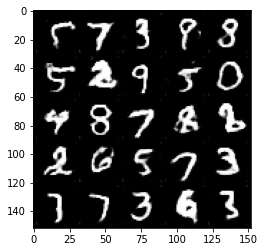

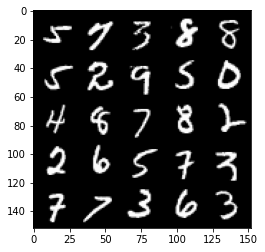

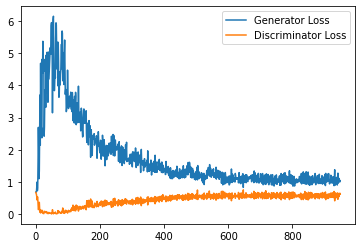

Step 19500: Generator loss: 1.047845247387886, discriminator loss: 0.5866089233160019


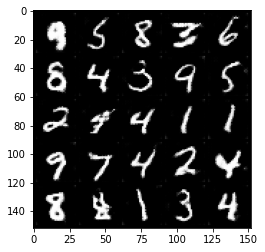

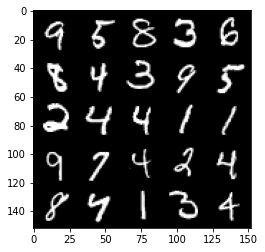

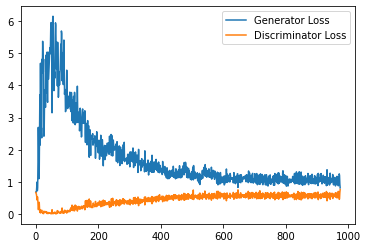

Step 20000: Generator loss: 1.0806498733758927, discriminator loss: 0.5810474194288254


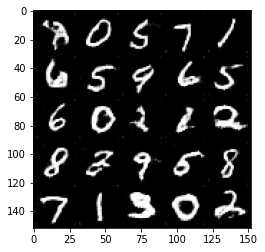

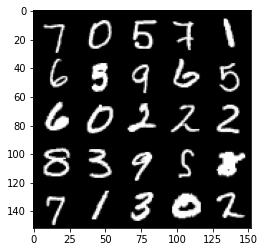

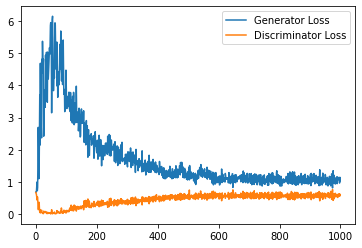

Step 20500: Generator loss: 1.0399927742481232, discriminator loss: 0.5867614913582802


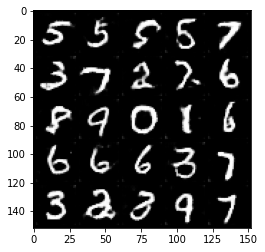

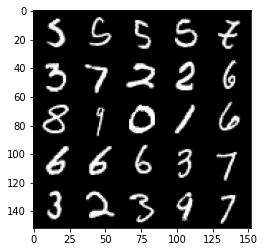

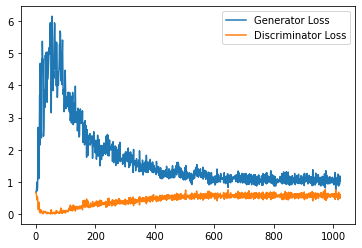

Step 21000: Generator loss: 1.0327244440317154, discriminator loss: 0.5885510692596435


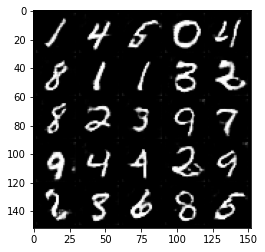

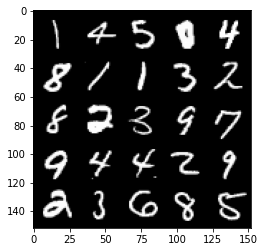

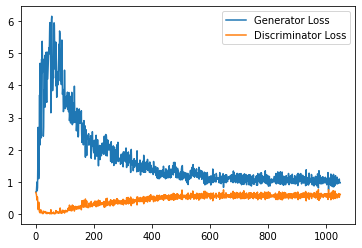

Step 21500: Generator loss: 1.004603954076767, discriminator loss: 0.5847974728941917


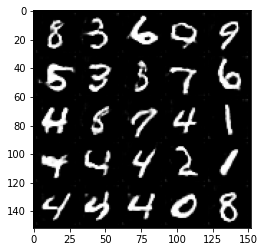

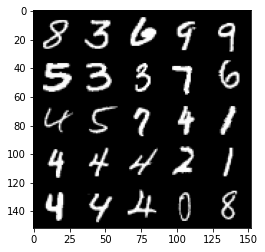

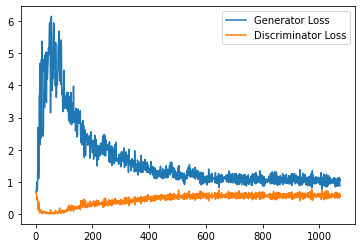

Step 22000: Generator loss: 1.0389928424358368, discriminator loss: 0.5848881672620774


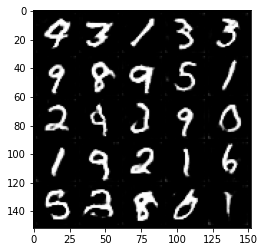

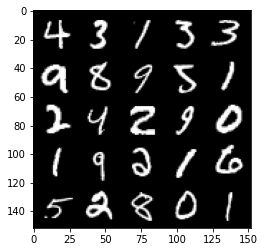

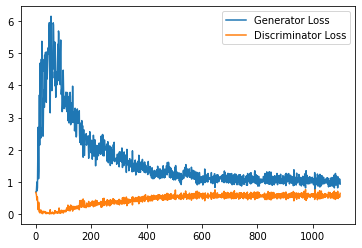

Step 22500: Generator loss: 1.032299658536911, discriminator loss: 0.5861773469448089


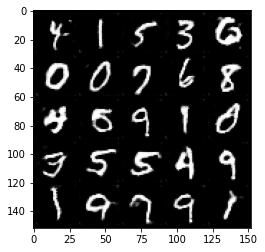

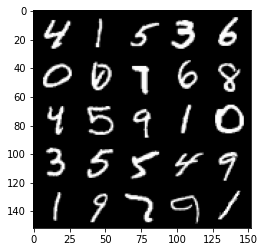

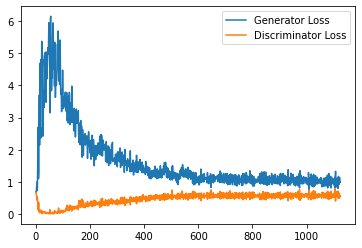

Step 23000: Generator loss: 1.049459706544876, discriminator loss: 0.5884157605171204


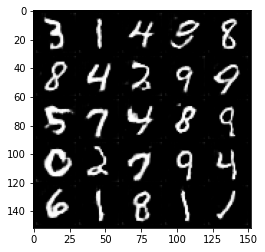

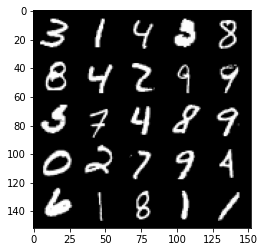

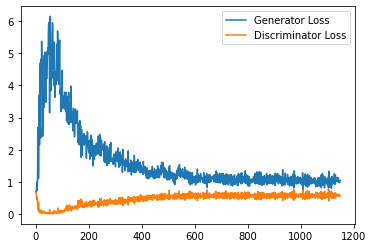

Step 23500: Generator loss: 1.0287952439785004, discriminator loss: 0.5887739933729171


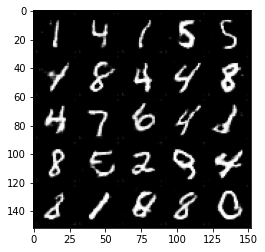

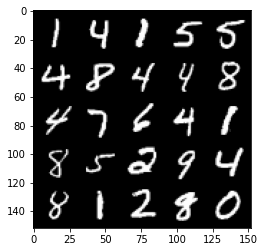

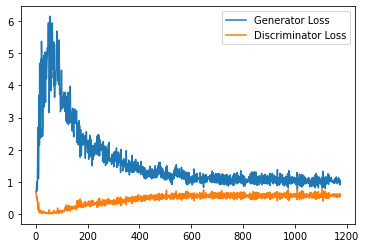

Step 24000: Generator loss: 1.0476260850429535, discriminator loss: 0.579281734764576


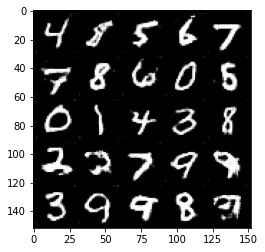

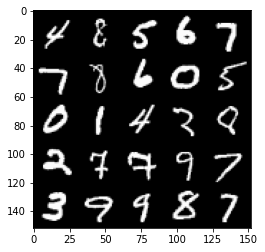

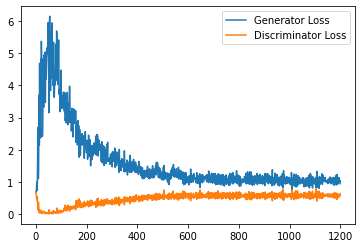

Step 24500: Generator loss: 1.0406927609443664, discriminator loss: 0.5830527552366257


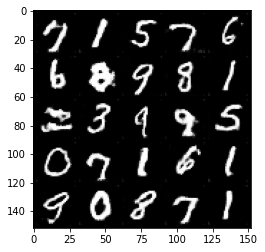

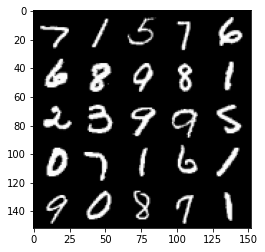

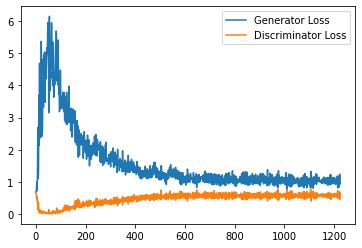

Step 25000: Generator loss: 1.0050732575654984, discriminator loss: 0.591181756079197


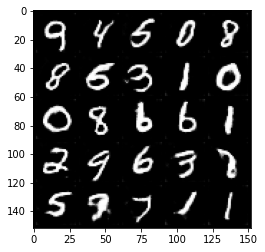

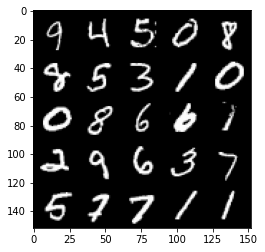

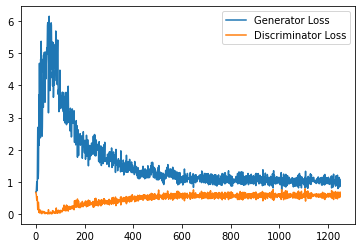

Step 25500: Generator loss: 1.0193410246372223, discriminator loss: 0.5844433829188347


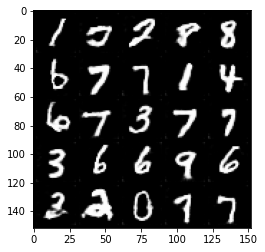

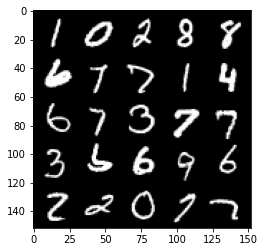

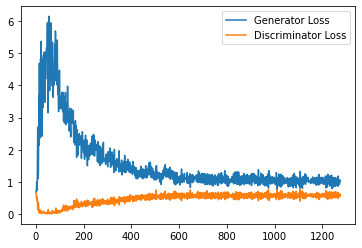

Step 26000: Generator loss: 0.9909647707939148, discriminator loss: 0.5870253825187683


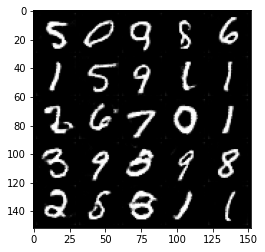

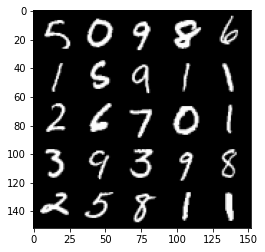

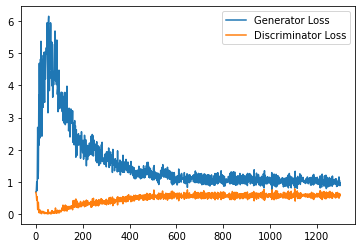

Step 26500: Generator loss: 1.0163989914655684, discriminator loss: 0.5898147805333137


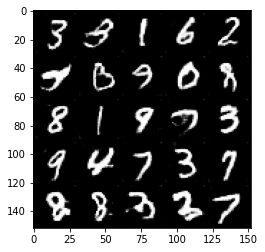

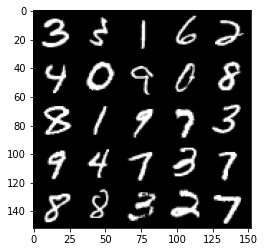

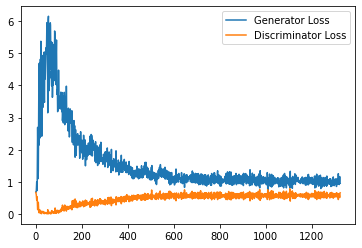

Step 27000: Generator loss: 1.03410730946064, discriminator loss: 0.5921898138523102


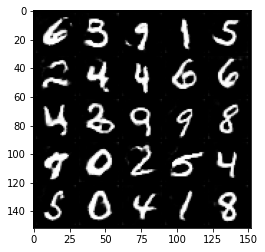

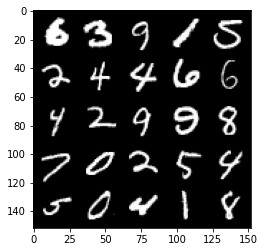

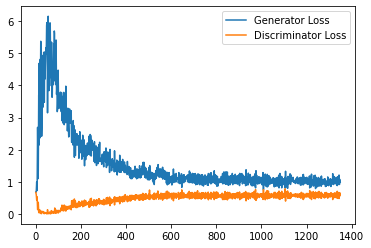

Step 27500: Generator loss: 1.0188405274152756, discriminator loss: 0.5875392843484879


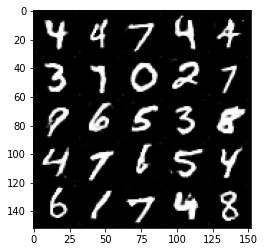

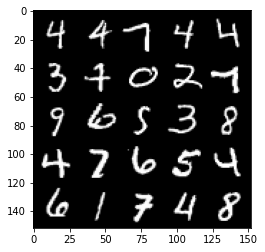

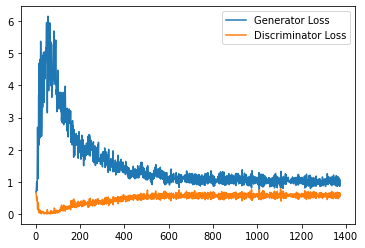

Step 28000: Generator loss: 1.015474017739296, discriminator loss: 0.5833623111248016


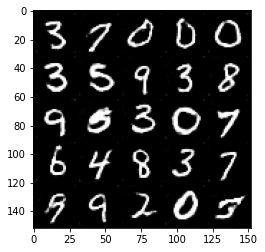

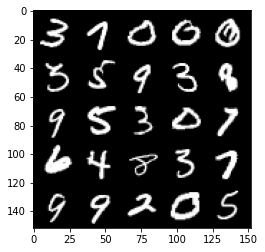

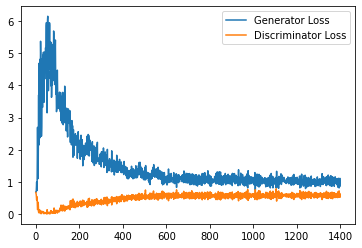

Step 28500: Generator loss: 1.0377722190618515, discriminator loss: 0.5815930606722832


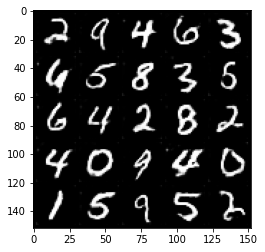

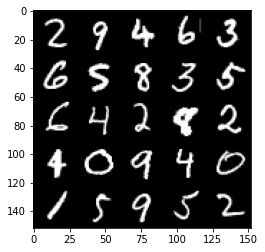

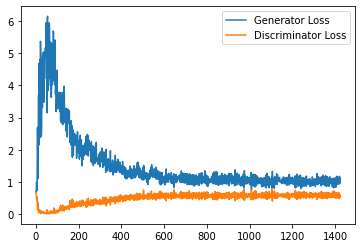

Step 29000: Generator loss: 1.035141547679901, discriminator loss: 0.5872329468727112


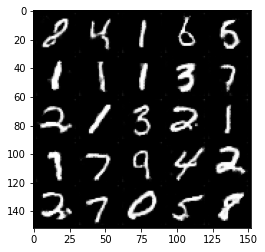

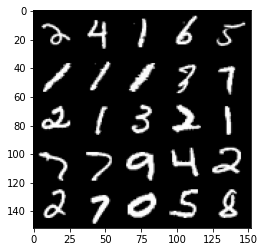

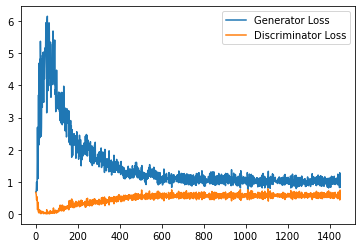

Step 29500: Generator loss: 1.0175643824338914, discriminator loss: 0.5791538200974464


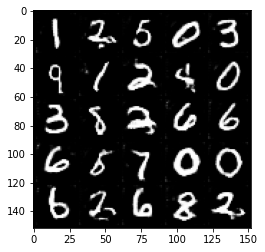

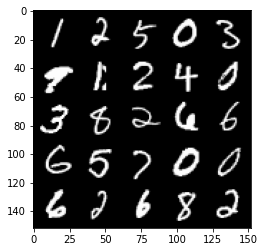

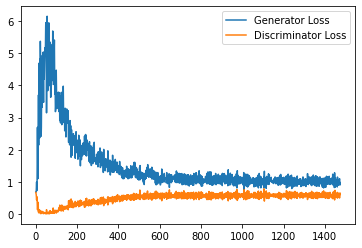

Step 30000: Generator loss: 1.0334209209680558, discriminator loss: 0.5755380242466926


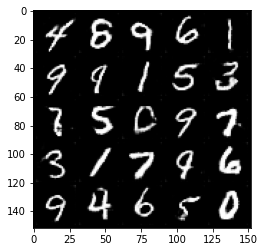

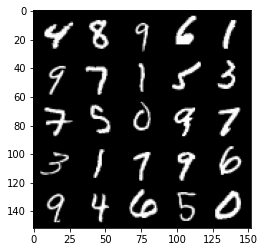

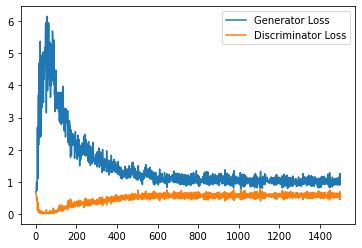

Step 30500: Generator loss: 1.0244388843774797, discriminator loss: 0.5879714494347572


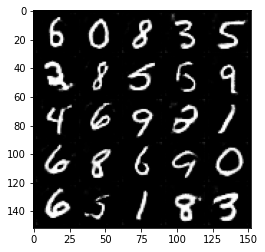

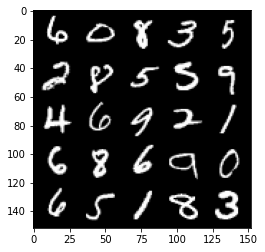

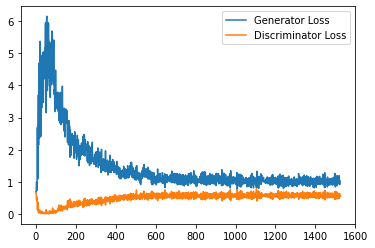

Step 31000: Generator loss: 1.0248066885471343, discriminator loss: 0.5796464999914169


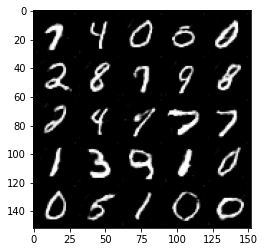

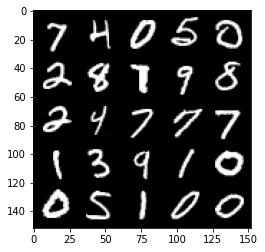

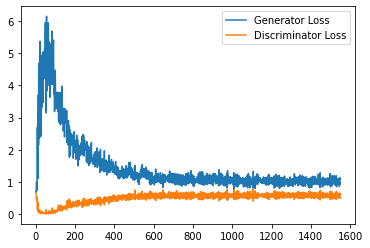

Step 31500: Generator loss: 1.0187076342105865, discriminator loss: 0.588965412735939


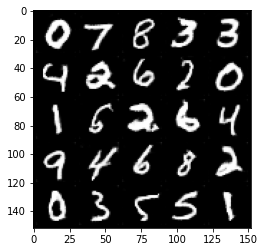

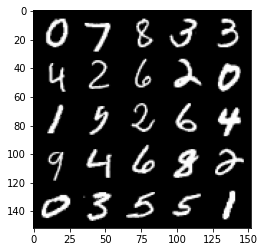

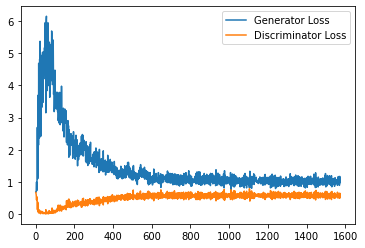

Step 32000: Generator loss: 1.0542088619470595, discriminator loss: 0.5815453560948372


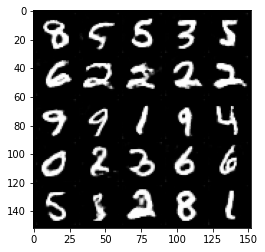

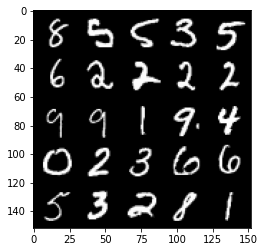

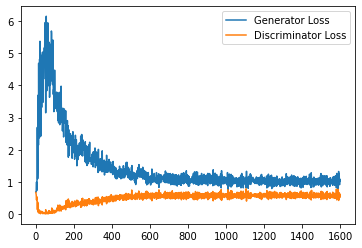

Step 32500: Generator loss: 1.0211557011604309, discriminator loss: 0.5783562468290329


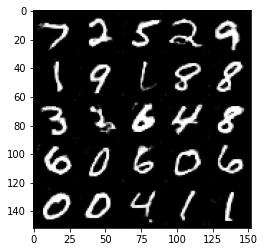

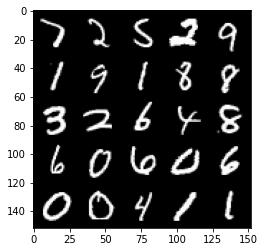

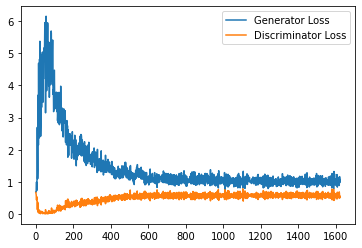

Step 33000: Generator loss: 1.0265976902246474, discriminator loss: 0.587848876953125


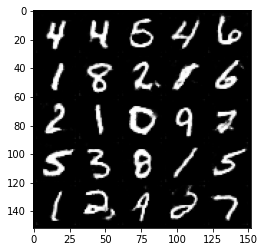

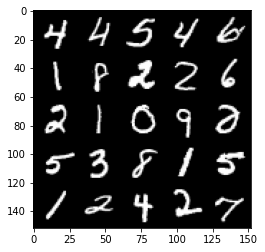

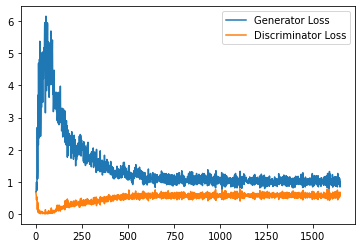

Step 33500: Generator loss: 1.0490317474603652, discriminator loss: 0.5803968463540077


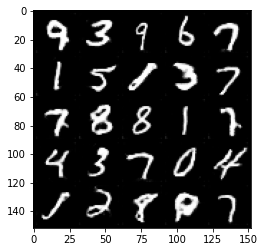

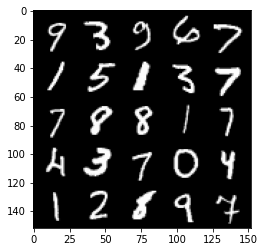

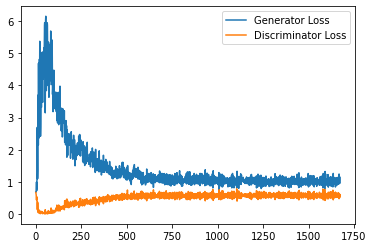

Step 34000: Generator loss: 1.0320608381032943, discriminator loss: 0.5788089305162429


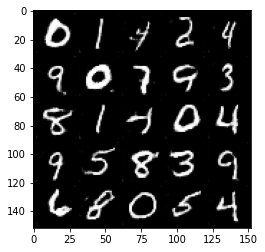

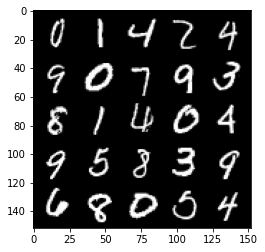

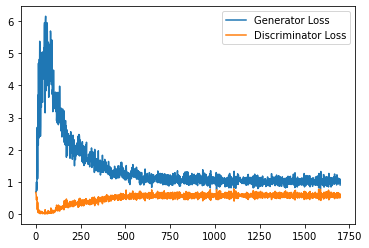

Step 34500: Generator loss: 1.0222628599405288, discriminator loss: 0.5834309893250466


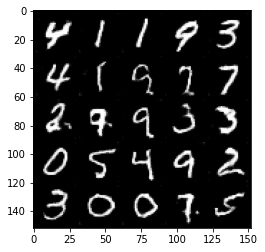

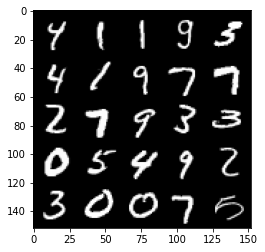

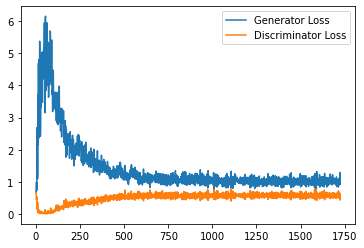

Step 35000: Generator loss: 1.0298022991418838, discriminator loss: 0.5817869743108749


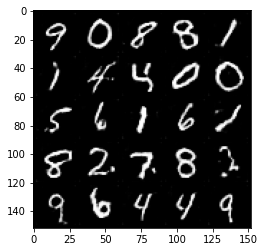

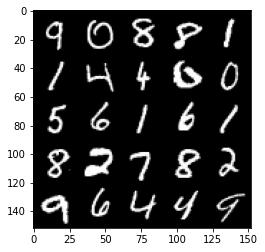

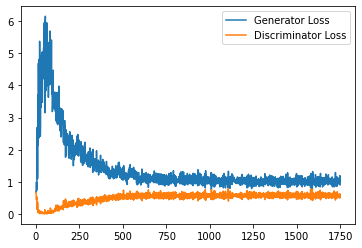

Step 35500: Generator loss: 1.0361855310201644, discriminator loss: 0.5756574134230614


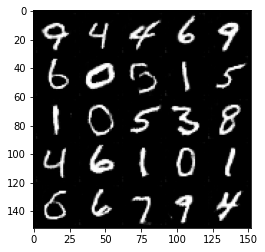

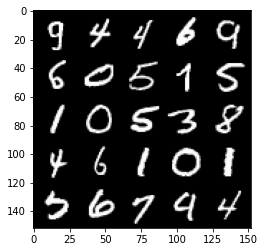

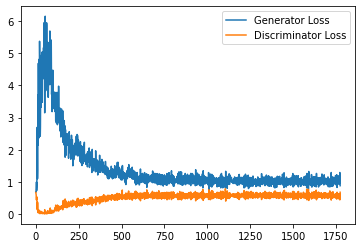

Step 36000: Generator loss: 1.0541623457670213, discriminator loss: 0.5703153034448624


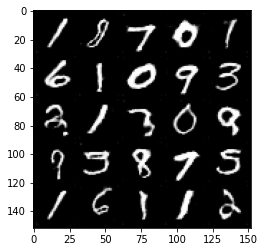

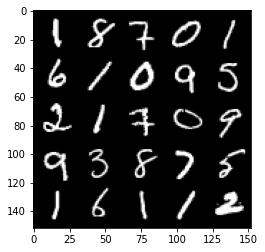

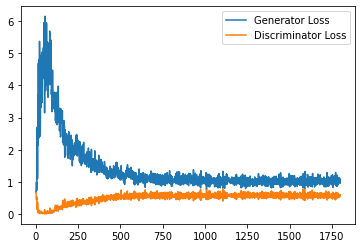

Step 36500: Generator loss: 1.0547759664058685, discriminator loss: 0.5710366891622544


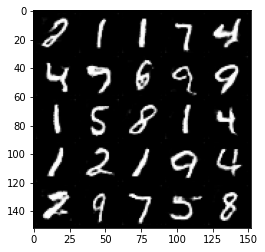

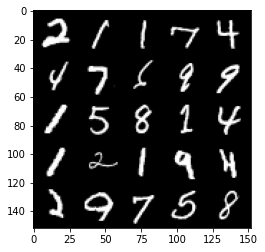

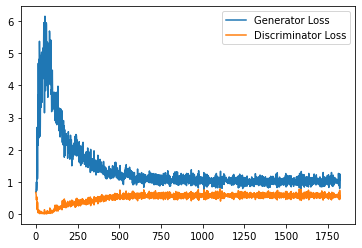

Step 37000: Generator loss: 1.0470984001159669, discriminator loss: 0.5773072500228882


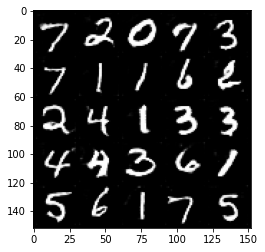

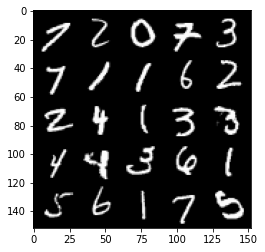

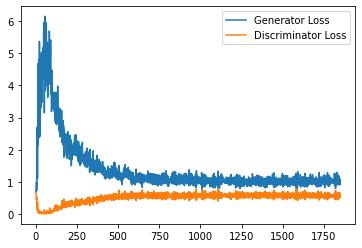

Step 37500: Generator loss: 1.0392269057035446, discriminator loss: 0.5783990814685821


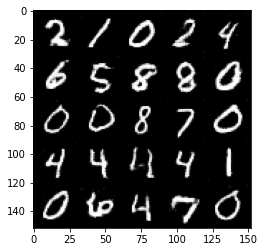

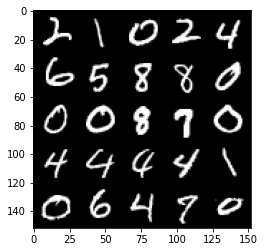

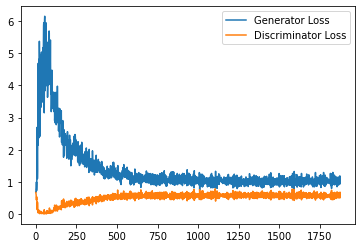

Step 38000: Generator loss: 1.0692692393064498, discriminator loss: 0.5741627323627472


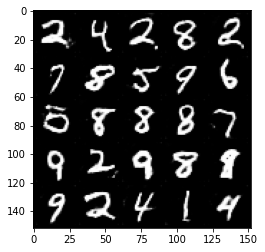

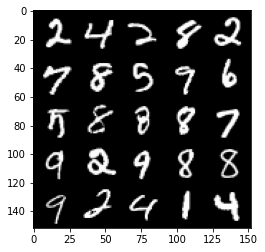

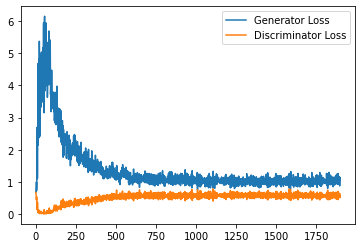

Step 38500: Generator loss: 1.040093912601471, discriminator loss: 0.5751500437855721


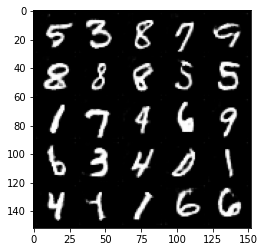

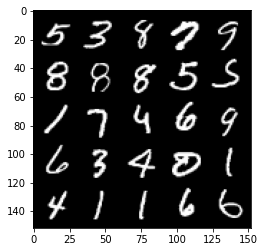

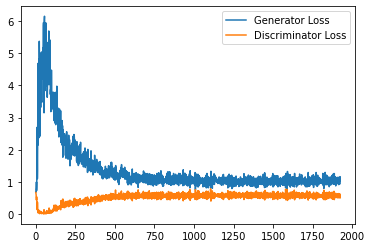

Step 39000: Generator loss: 1.039746338367462, discriminator loss: 0.5795995196700097


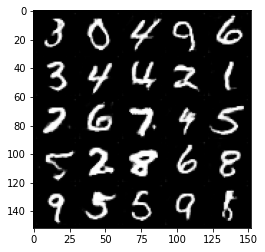

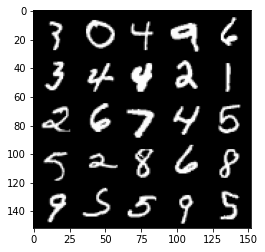

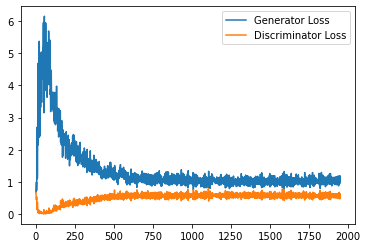

Step 39500: Generator loss: 1.0541654608249664, discriminator loss: 0.5762156313061714


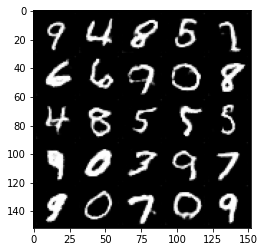

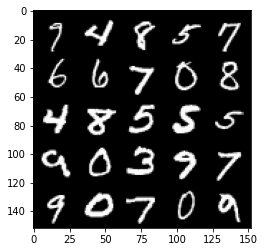

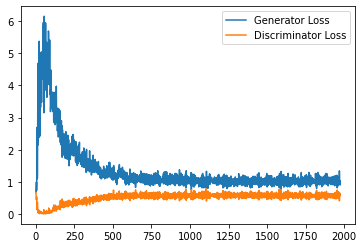

Step 40000: Generator loss: 1.0530544891357423, discriminator loss: 0.5718925278782845


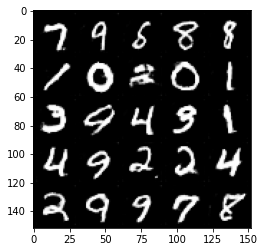

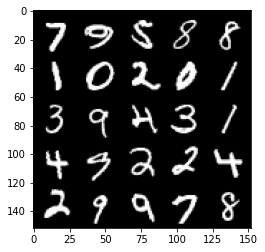

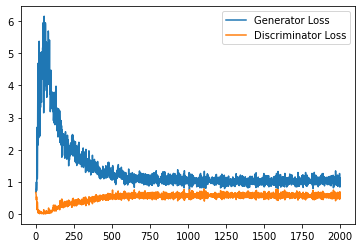

Step 40500: Generator loss: 1.0469415953159333, discriminator loss: 0.5703745603561401


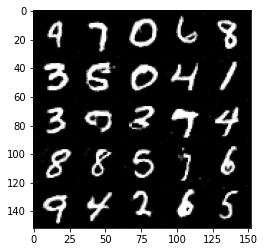

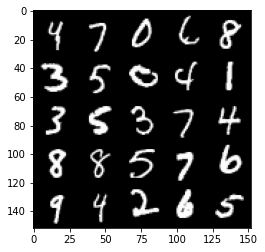

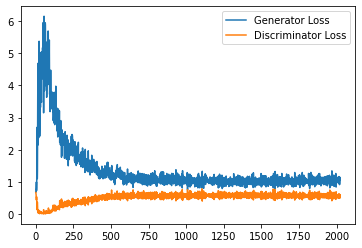

Step 41000: Generator loss: 1.053776848435402, discriminator loss: 0.5743626618385315


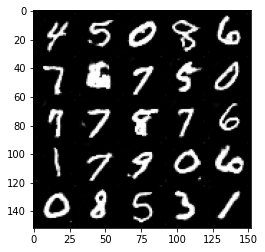

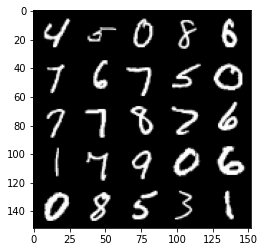

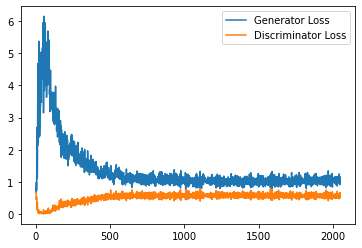

Step 41500: Generator loss: 1.0599499702453614, discriminator loss: 0.5720327042937279


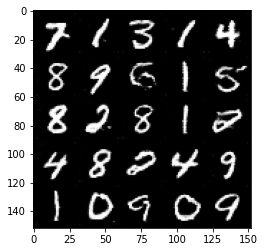

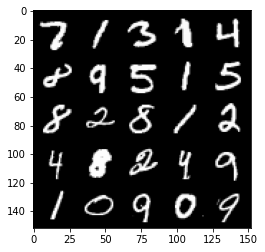

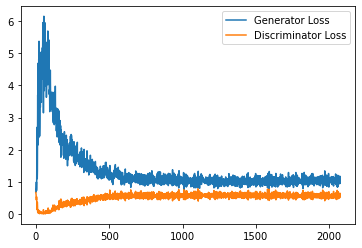

Step 42000: Generator loss: 1.0509574683904648, discriminator loss: 0.5702025734186172


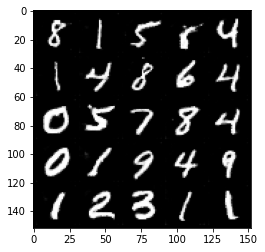

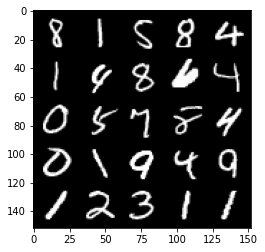

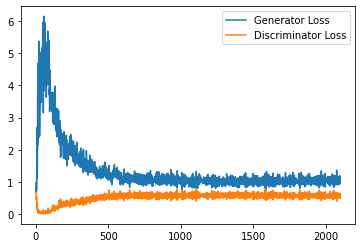

Step 42500: Generator loss: 1.0526511064767838, discriminator loss: 0.5639146713614464


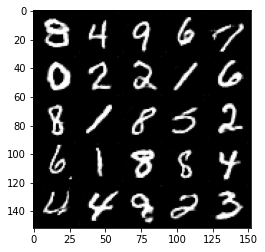

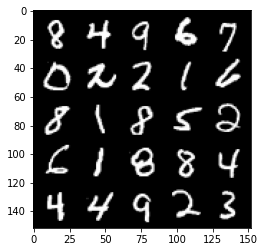

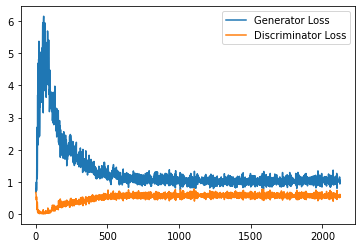

Step 43000: Generator loss: 1.0572052286863327, discriminator loss: 0.5704699997901916


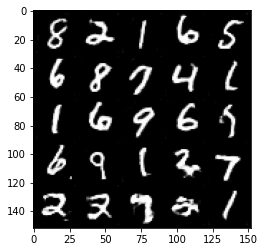

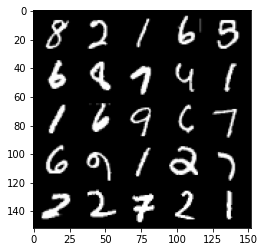

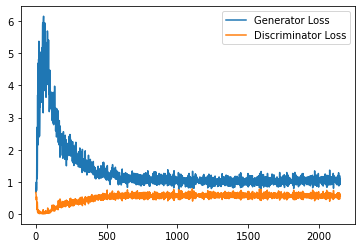

Step 43500: Generator loss: 1.0697089862823486, discriminator loss: 0.5622897441387177


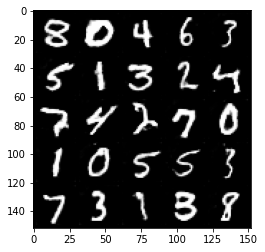

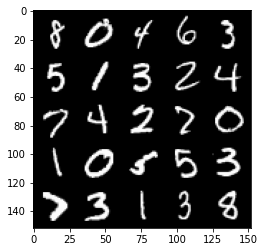

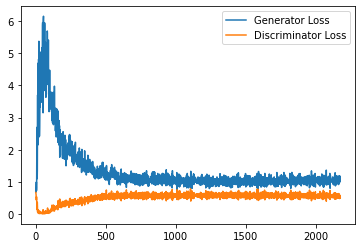

Step 44000: Generator loss: 1.0634825307130813, discriminator loss: 0.5706225579380989


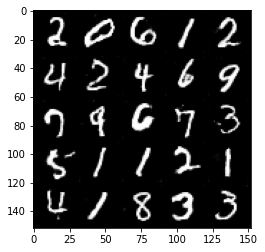

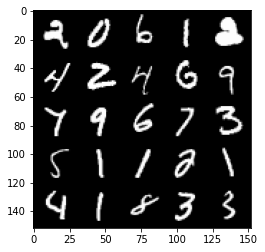

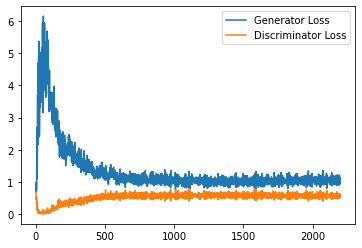

Step 44500: Generator loss: 1.0666330461502076, discriminator loss: 0.563366369664669


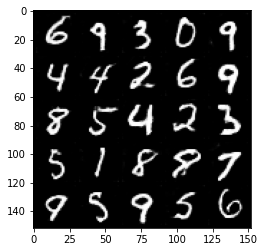

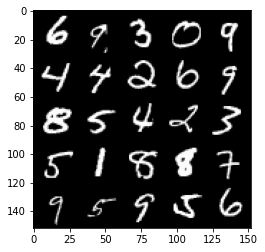

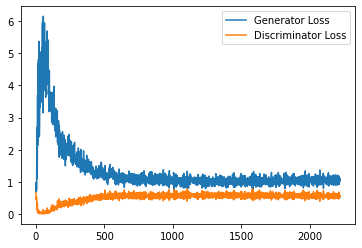

Step 45000: Generator loss: 1.0756800057888032, discriminator loss: 0.5664860555529594


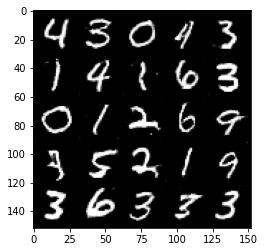

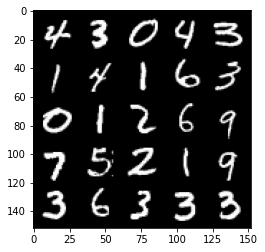

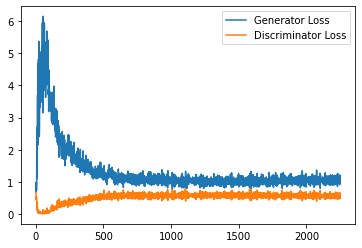

Step 45500: Generator loss: 1.0702524781227112, discriminator loss: 0.5651236673593522


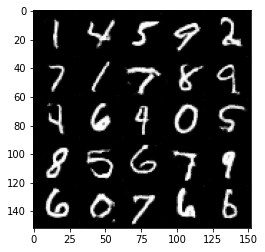

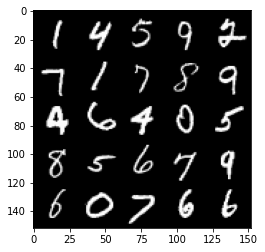

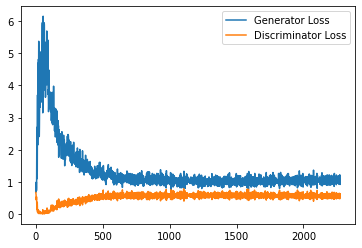

Step 46000: Generator loss: 1.0657736648321152, discriminator loss: 0.568974502146244


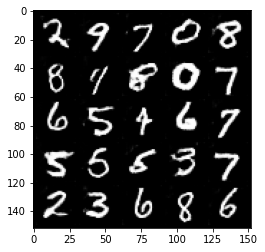

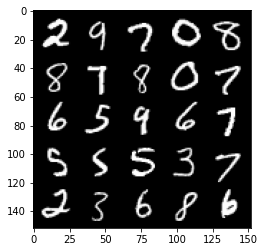

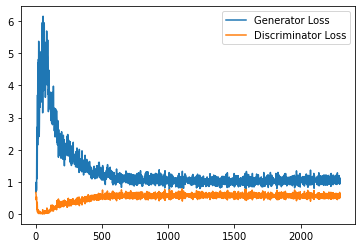

Step 46500: Generator loss: 1.0807564822435378, discriminator loss: 0.565642180621624


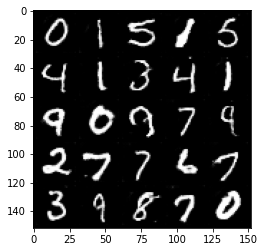

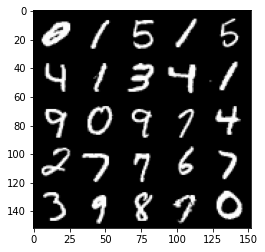

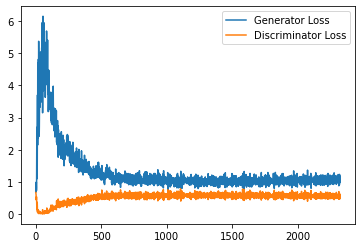

Step 47000: Generator loss: 1.0718063688278199, discriminator loss: 0.5676196814775467


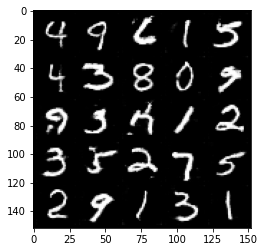

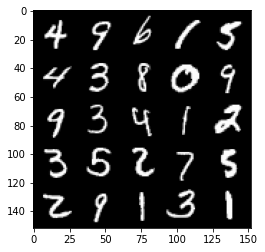

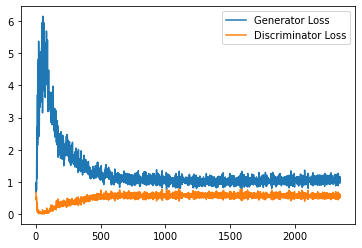

Step 47500: Generator loss: 1.0714661074876786, discriminator loss: 0.5640009151697158


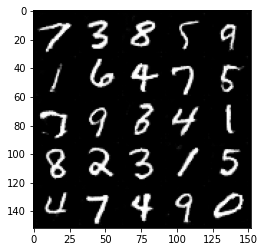

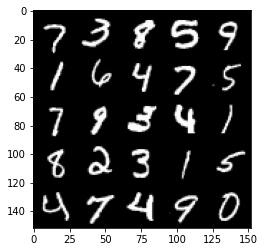

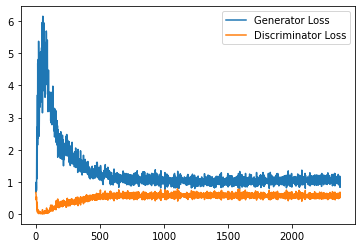

Step 48000: Generator loss: 1.089266783595085, discriminator loss: 0.5668591609597207


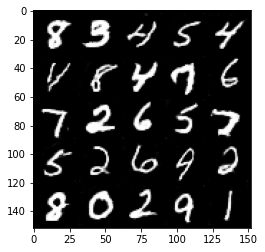

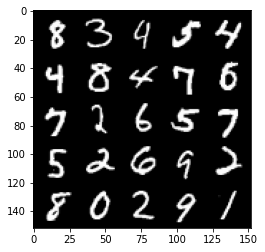

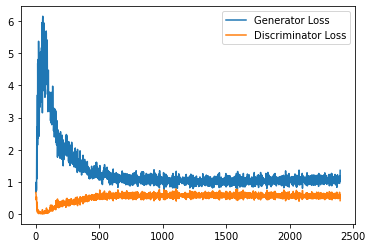

Step 48500: Generator loss: 1.077940935254097, discriminator loss: 0.5697008485794067


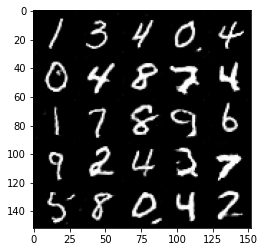

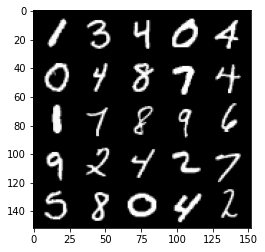

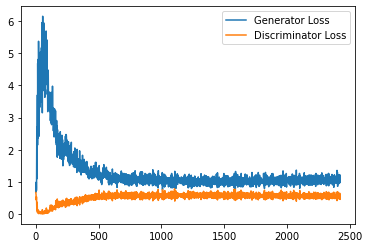

Step 49000: Generator loss: 1.0576001967191697, discriminator loss: 0.5740367428660392


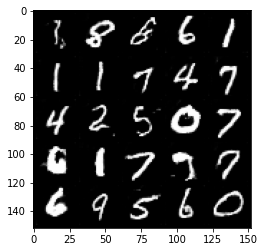

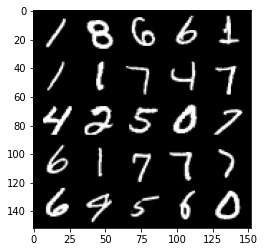

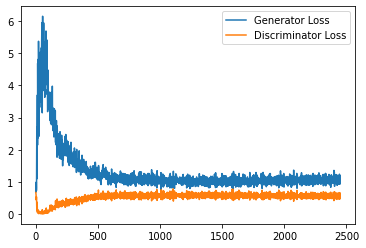

Step 49500: Generator loss: 1.0575383282899857, discriminator loss: 0.5604909255504608


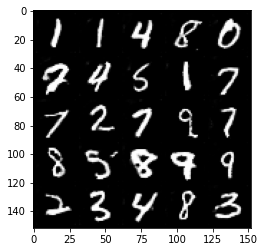

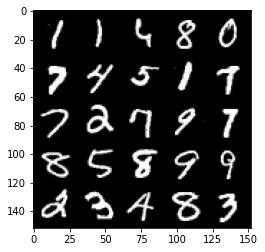

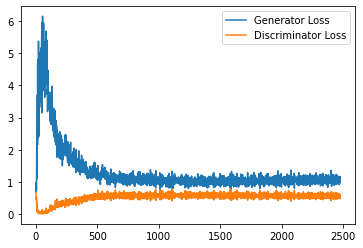

Step 50000: Generator loss: 1.071868776202202, discriminator loss: 0.5675589221715928


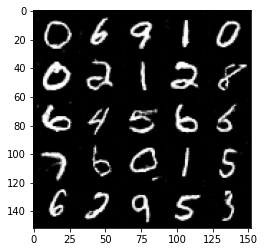

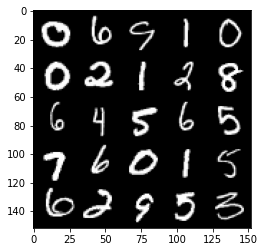

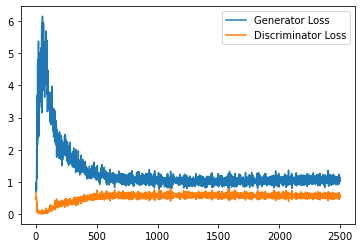

Step 50500: Generator loss: 1.0755318486690522, discriminator loss: 0.5628568596839905


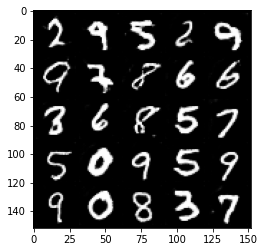

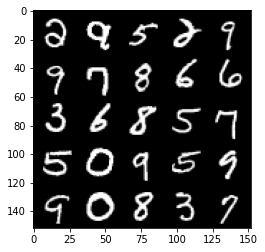

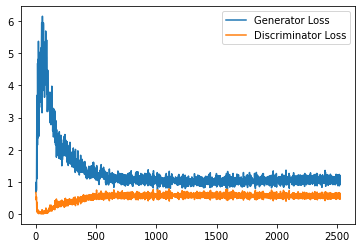

Step 51000: Generator loss: 1.0778447459936142, discriminator loss: 0.5635767809152603


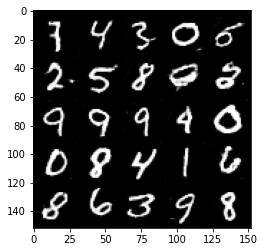

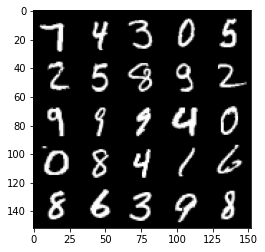

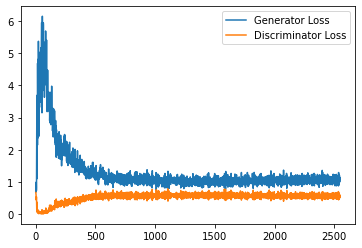

Step 51500: Generator loss: 1.0847431385517121, discriminator loss: 0.5685629556775094


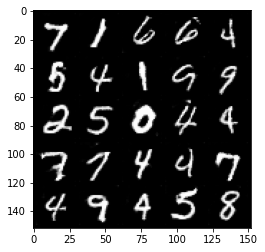

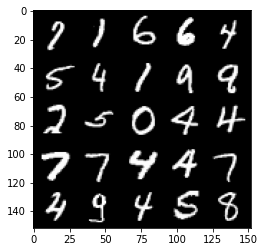

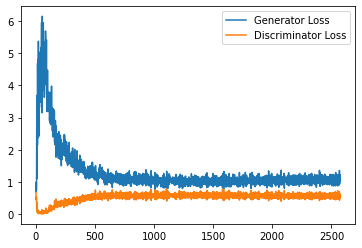

Step 52000: Generator loss: 1.0808643518686294, discriminator loss: 0.5656483496427536


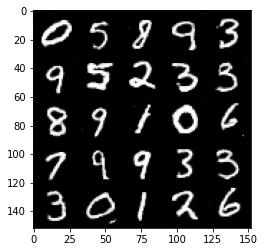

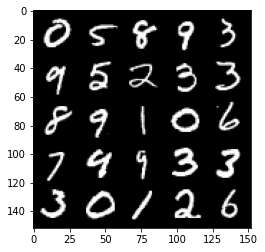

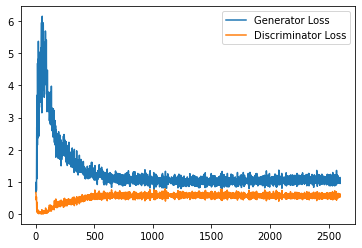

Step 52500: Generator loss: 1.0975620098114014, discriminator loss: 0.5659105235338211


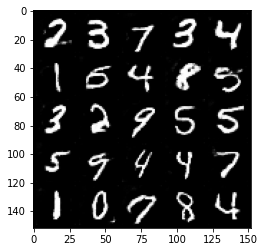

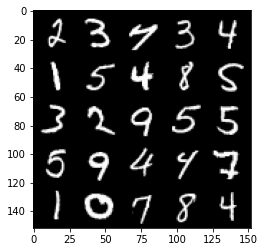

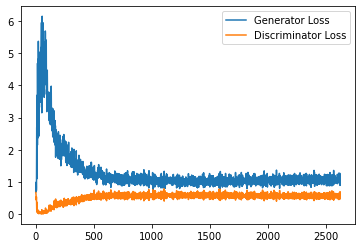

Step 53000: Generator loss: 1.0811714127063752, discriminator loss: 0.5652607484459877


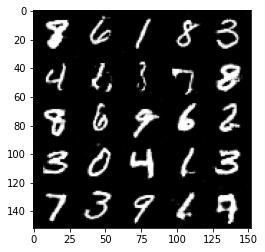

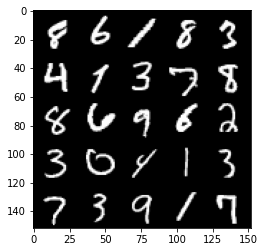

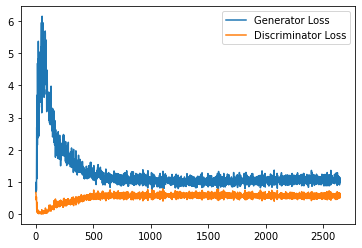

Step 53500: Generator loss: 1.0673895202875137, discriminator loss: 0.5641394962072372


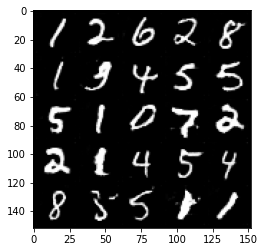

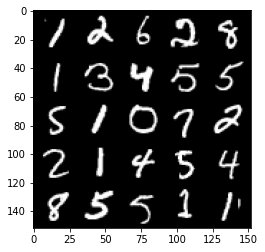

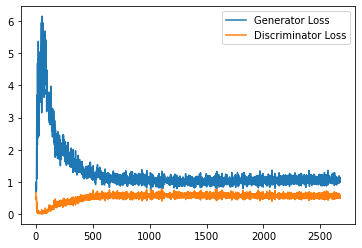

Step 54000: Generator loss: 1.0723619850873947, discriminator loss: 0.5608909364938736


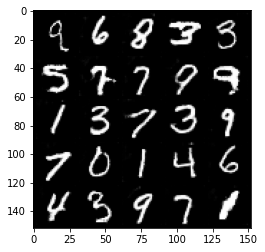

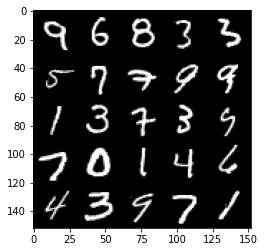

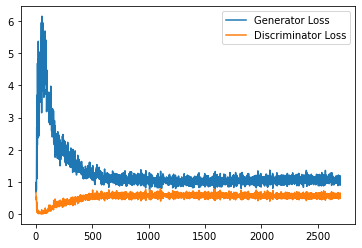

Step 54500: Generator loss: 1.1023845264911651, discriminator loss: 0.5620535367131233


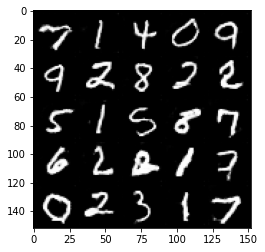

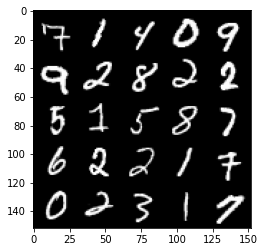

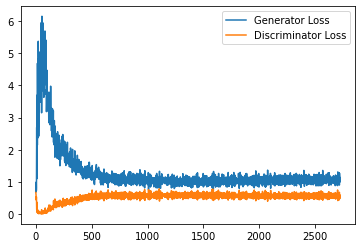

Step 55000: Generator loss: 1.073178085565567, discriminator loss: 0.5639054889678955


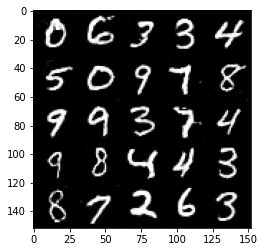

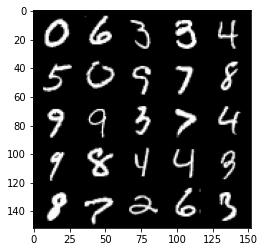

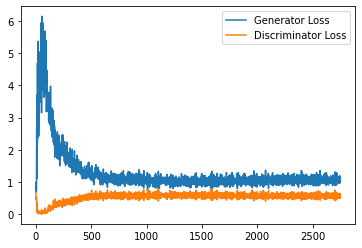

Step 55500: Generator loss: 1.0822631880044937, discriminator loss: 0.5641939198970795


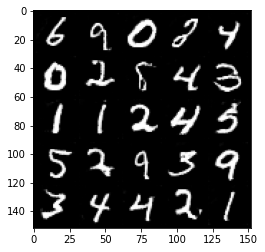

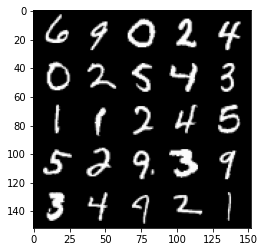

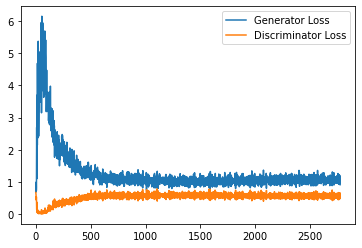

Step 56000: Generator loss: 1.101854271888733, discriminator loss: 0.5607428598403931


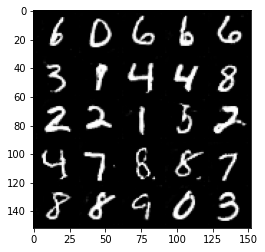

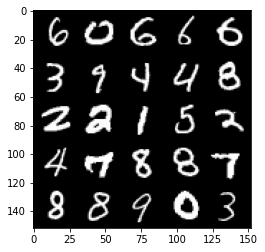

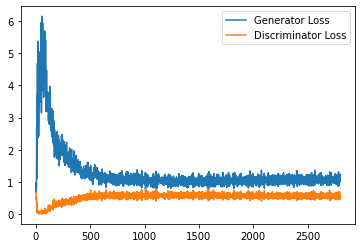

Step 56500: Generator loss: 1.08798843896389, discriminator loss: 0.5714210588335991


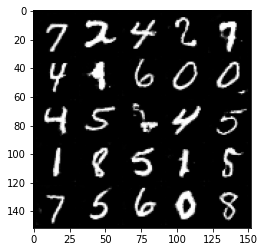

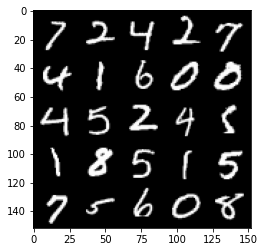

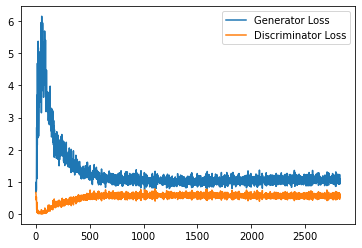

Step 57000: Generator loss: 1.0818113279342652, discriminator loss: 0.5600796726346016


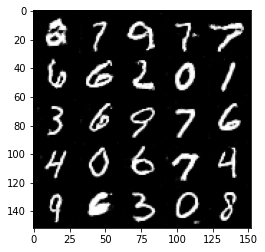

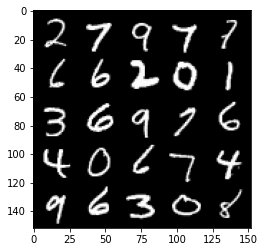

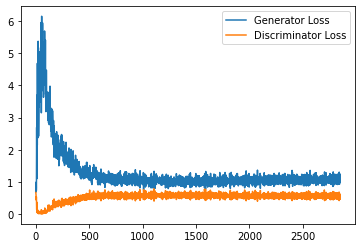

Step 57500: Generator loss: 1.0815407010316849, discriminator loss: 0.5625169354677201


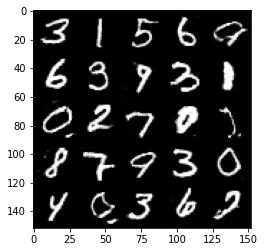

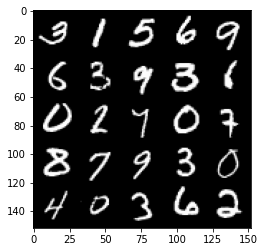

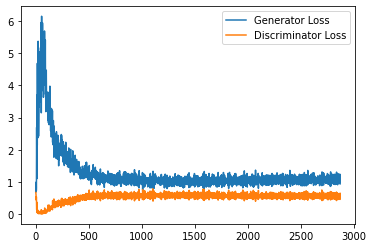

Step 58000: Generator loss: 1.0973958953619003, discriminator loss: 0.5509504132866859


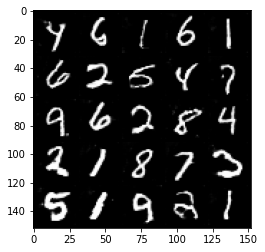

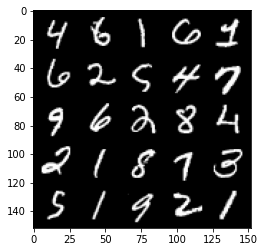

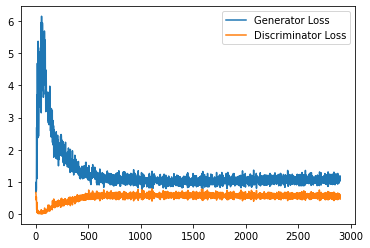

Step 58500: Generator loss: 1.0880134797096253, discriminator loss: 0.5642061274647713


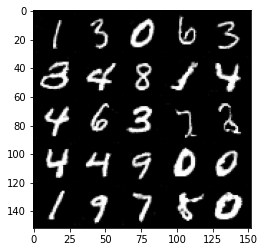

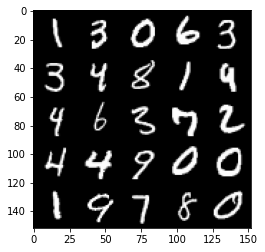

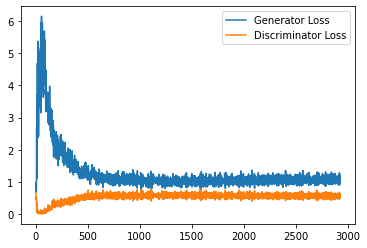

Step 59000: Generator loss: 1.100268069267273, discriminator loss: 0.5587596853375435


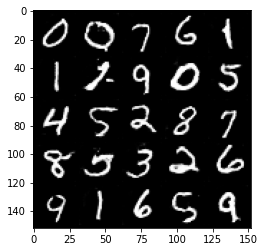

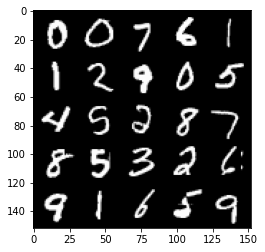

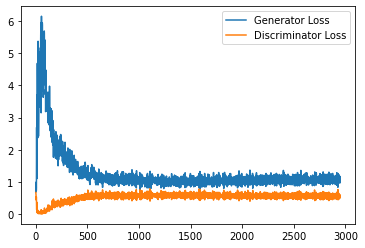

Step 59500: Generator loss: 1.0888396964073181, discriminator loss: 0.5648026567697525


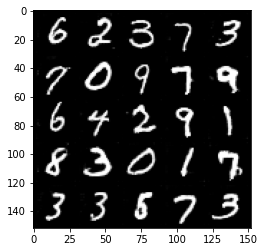

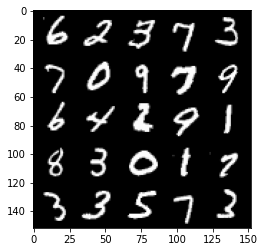

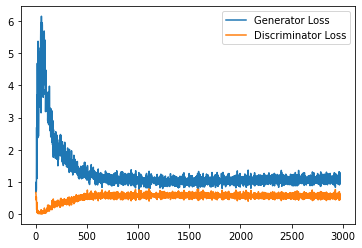

Step 60000: Generator loss: 1.0948470237255097, discriminator loss: 0.5588415265083313


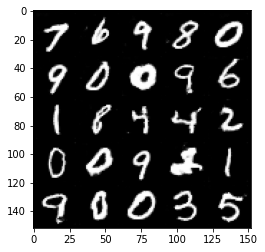

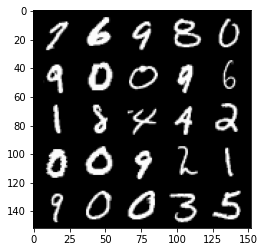

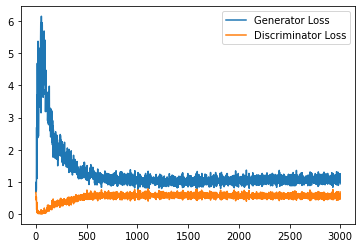

Step 60500: Generator loss: 1.093122144818306, discriminator loss: 0.5549557665586472


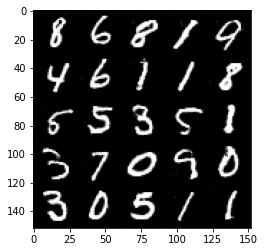

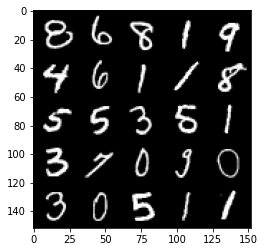

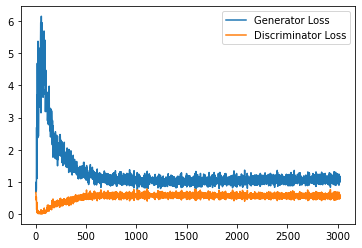

Step 61000: Generator loss: 1.0915050030946731, discriminator loss: 0.5576712852716446


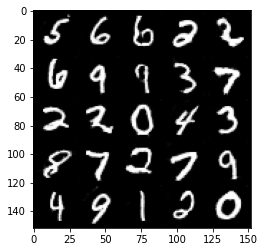

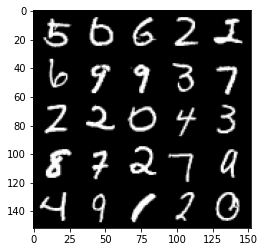

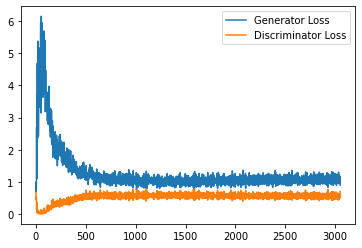

Step 61500: Generator loss: 1.1026235177516936, discriminator loss: 0.5524726614356041


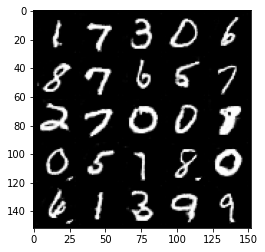

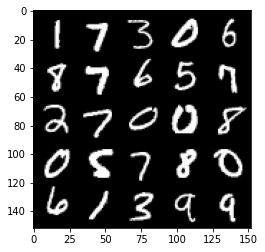

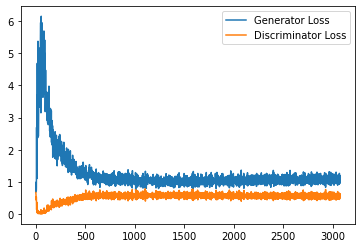

Step 62000: Generator loss: 1.126085280418396, discriminator loss: 0.5567807089090347


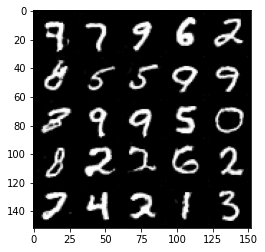

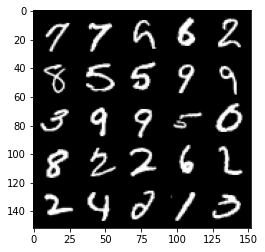

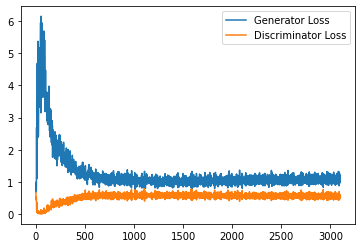

Step 62500: Generator loss: 1.11058524954319, discriminator loss: 0.5550028696656227


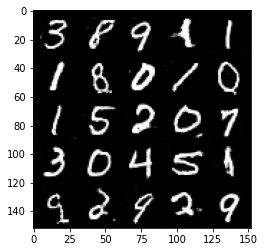

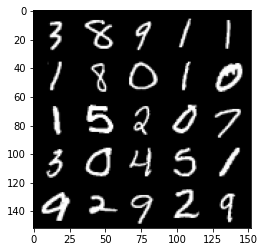

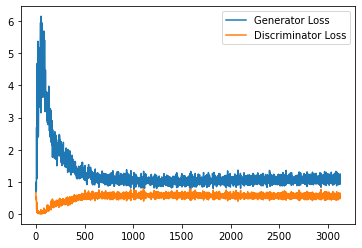

Step 63000: Generator loss: 1.1030183103084563, discriminator loss: 0.5632619051933289


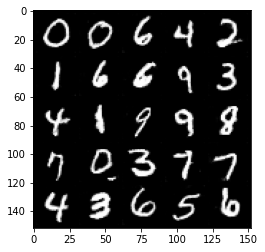

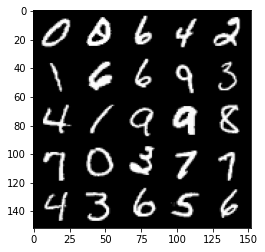

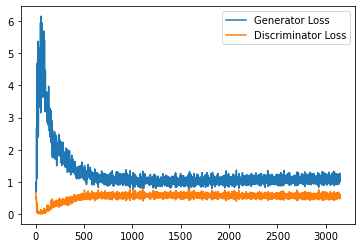

Step 63500: Generator loss: 1.103784992814064, discriminator loss: 0.559009064078331


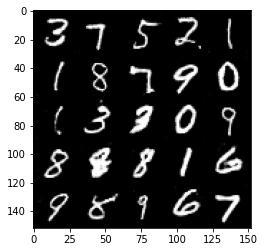

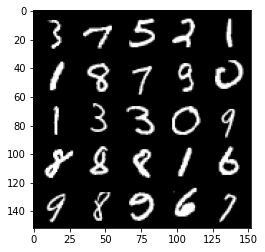

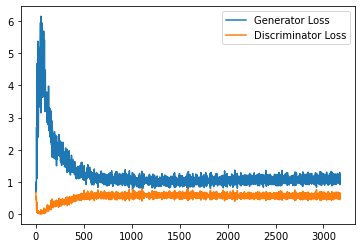

Step 64000: Generator loss: 1.1090125527381898, discriminator loss: 0.5527810193896293


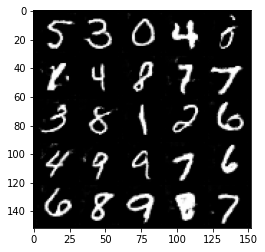

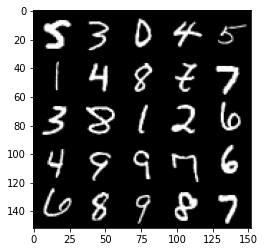

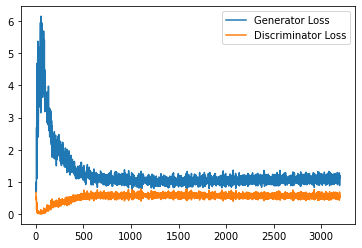

Step 64500: Generator loss: 1.1164395275115966, discriminator loss: 0.5566379597783089


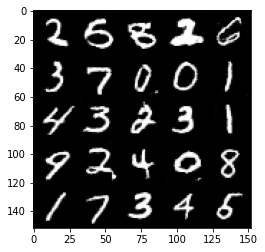

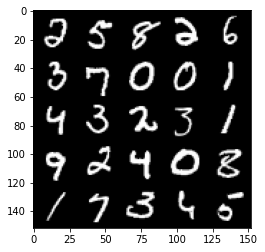

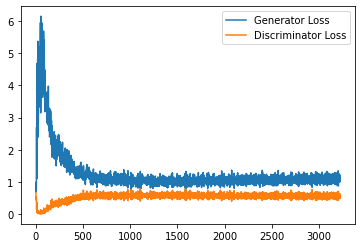

Step 65000: Generator loss: 1.124898316025734, discriminator loss: 0.5542632546424866


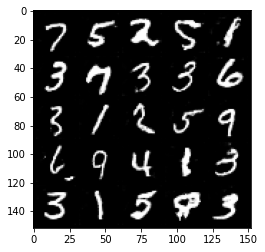

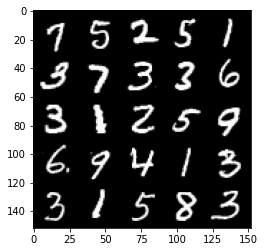

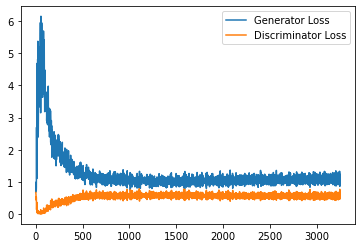

Step 65500: Generator loss: 1.111119503736496, discriminator loss: 0.5585189555287361


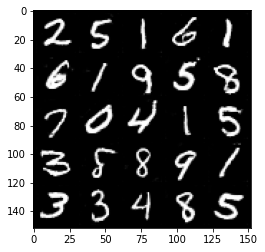

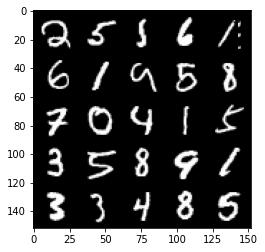

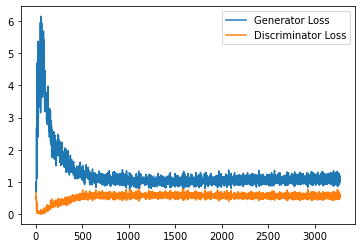

Step 66000: Generator loss: 1.1034315230846405, discriminator loss: 0.555904965043068


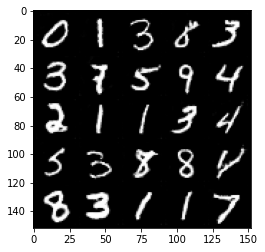

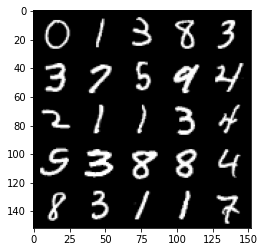

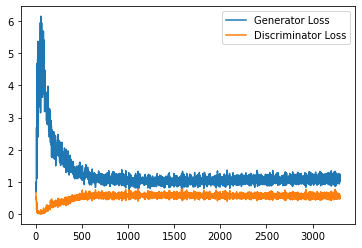

Step 66500: Generator loss: 1.1100276739597321, discriminator loss: 0.5573317466378211


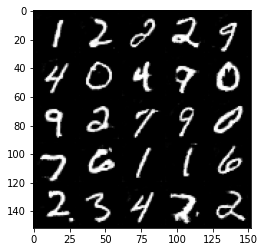

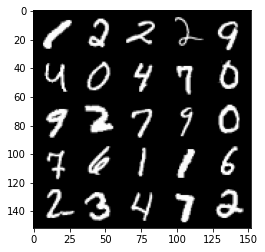

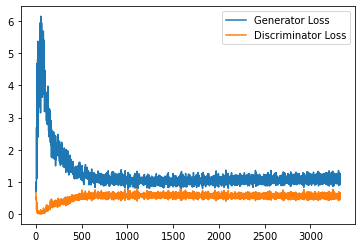

Step 67000: Generator loss: 1.115994511604309, discriminator loss: 0.5555855963230133


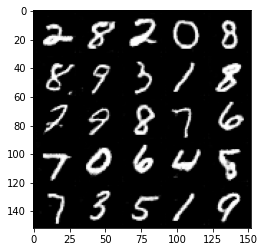

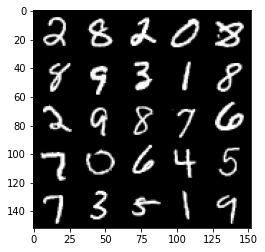

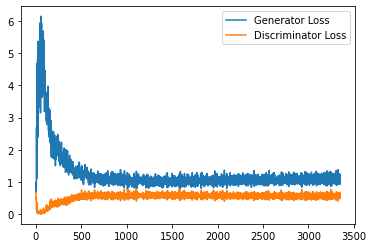

Step 67500: Generator loss: 1.133417820930481, discriminator loss: 0.5574393603801727


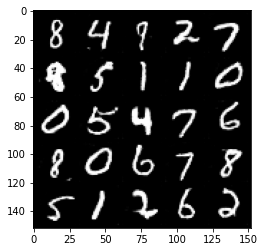

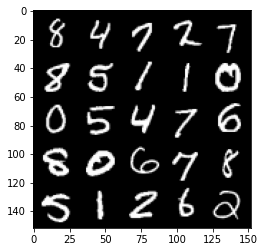

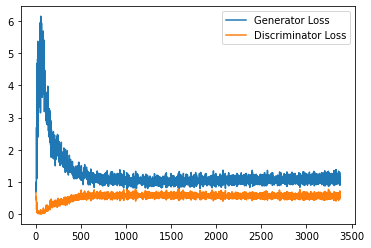

Step 68000: Generator loss: 1.1167930163145066, discriminator loss: 0.5530310596227646


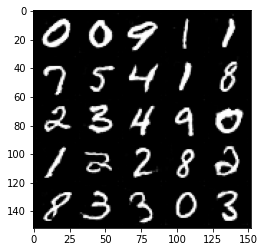

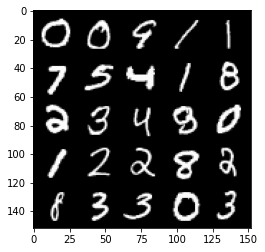

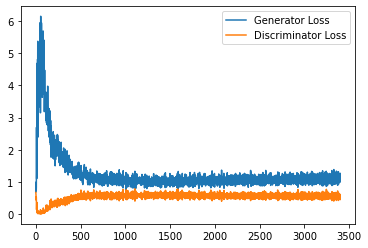

Step 68500: Generator loss: 1.1053278059959413, discriminator loss: 0.5593868707418441


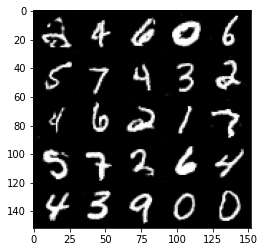

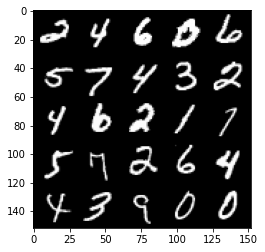

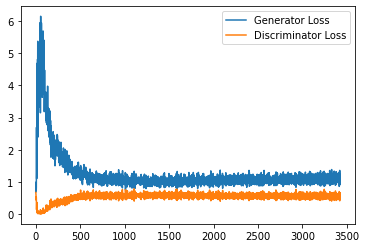

Step 69000: Generator loss: 1.1319915764331818, discriminator loss: 0.5458939414024353


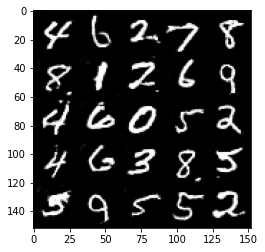

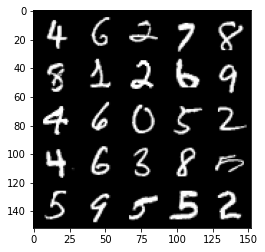

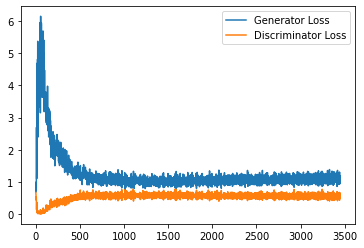

Step 69500: Generator loss: 1.1275669147968292, discriminator loss: 0.5575964169502259


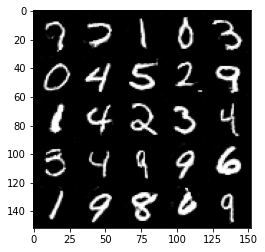

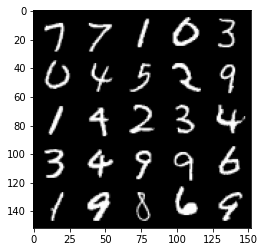

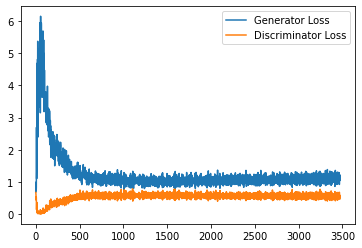

Step 70000: Generator loss: 1.0985200400352477, discriminator loss: 0.5613968086838722


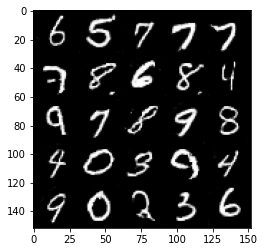

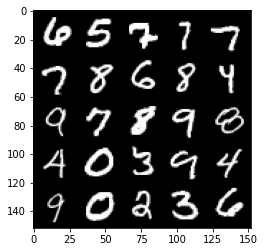

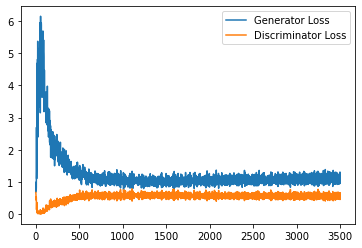

Step 70500: Generator loss: 1.1272021697759629, discriminator loss: 0.5486143151521683


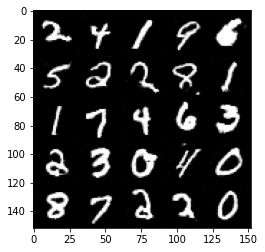

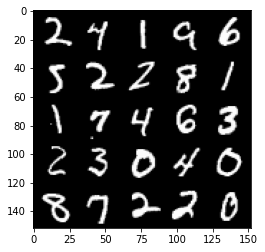

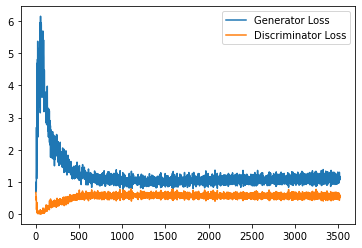

Step 71000: Generator loss: 1.1381205199956894, discriminator loss: 0.5463181746602058


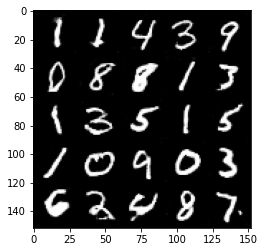

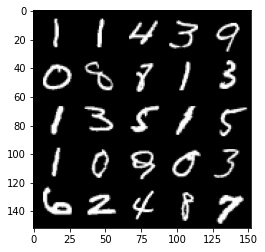

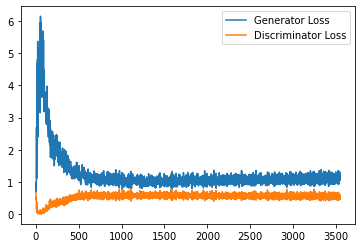

Step 71500: Generator loss: 1.1123335573673248, discriminator loss: 0.5578945732712746


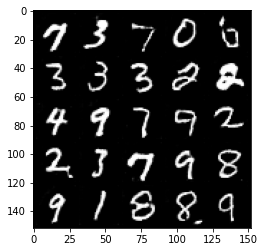

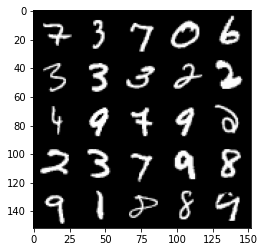

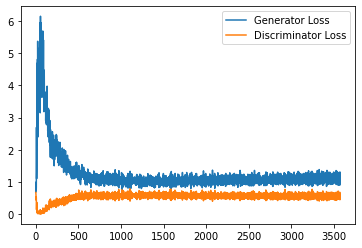

Step 72000: Generator loss: 1.1163035999536515, discriminator loss: 0.557755428314209


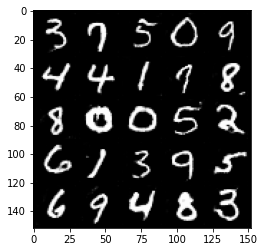

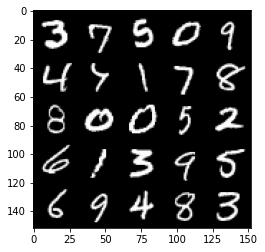

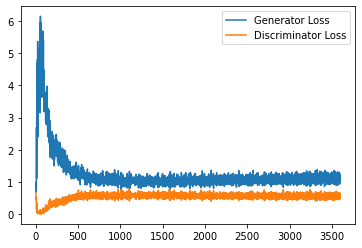

Step 72500: Generator loss: 1.1157155886888503, discriminator loss: 0.5597903357744217


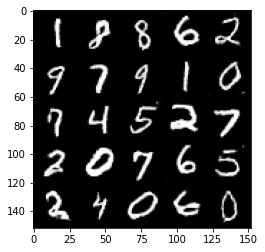

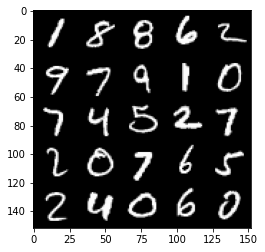

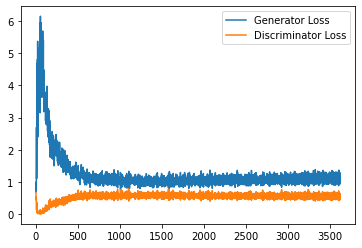

Step 73000: Generator loss: 1.1142224228382112, discriminator loss: 0.5589063618183135


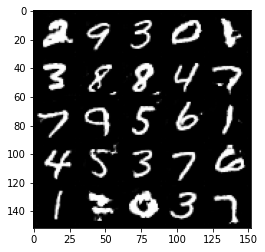

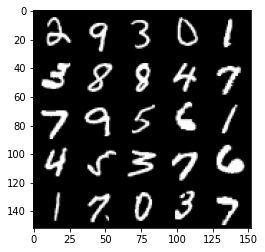

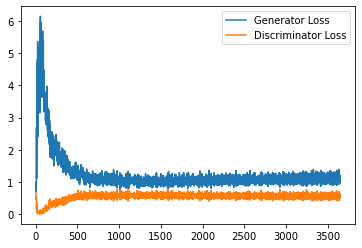

Step 73500: Generator loss: 1.1172048720121384, discriminator loss: 0.5517417486906052


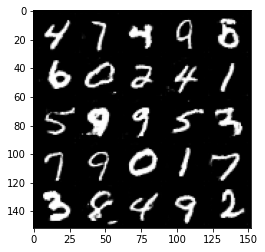

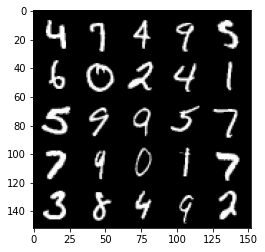

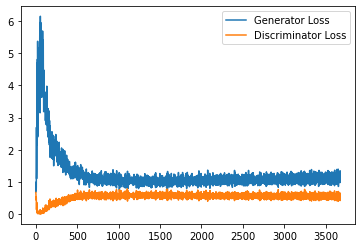

Step 74000: Generator loss: 1.1074334548711777, discriminator loss: 0.5643088025450707


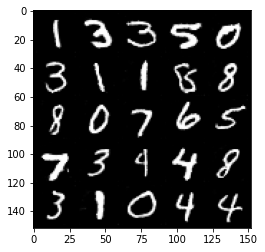

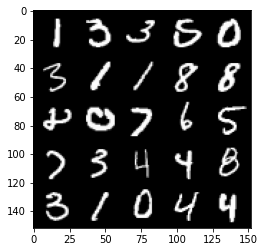

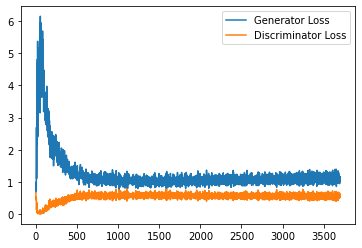

Step 74500: Generator loss: 1.1334087696075439, discriminator loss: 0.553566761791706


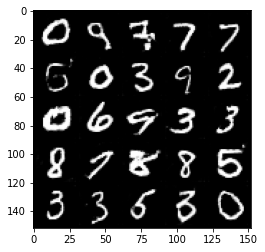

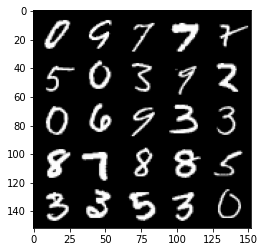

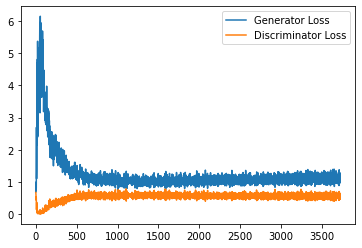

Step 75000: Generator loss: 1.1137565938234328, discriminator loss: 0.56056342202425


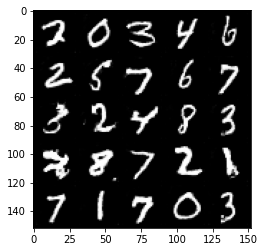

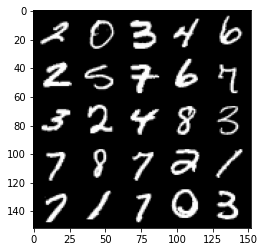

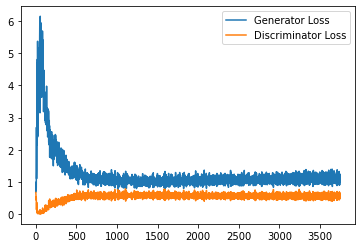

Step 75500: Generator loss: 1.1312989276647567, discriminator loss: 0.5532049899697303


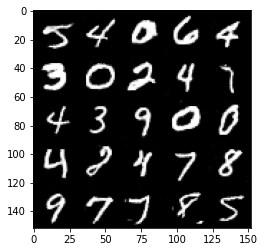

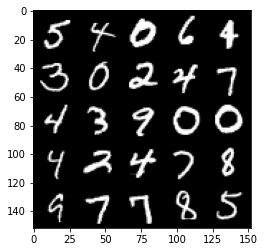

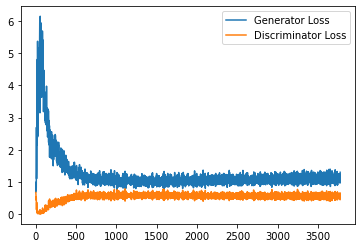

Step 76000: Generator loss: 1.1058411359786988, discriminator loss: 0.5607804753780365


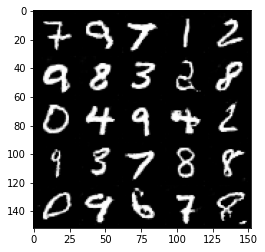

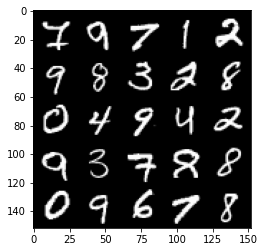

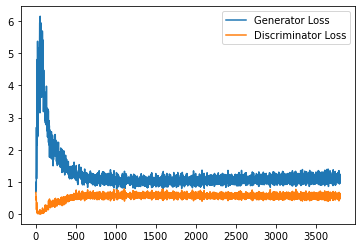

Step 76500: Generator loss: 1.1319174872636795, discriminator loss: 0.5561598269343376


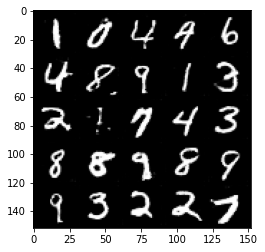

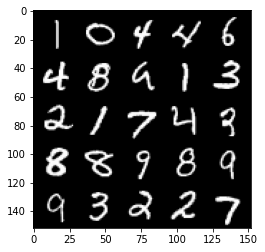

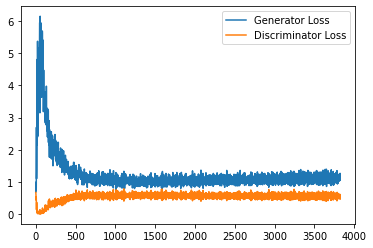

Step 77000: Generator loss: 1.1152064065933227, discriminator loss: 0.5643133018612861


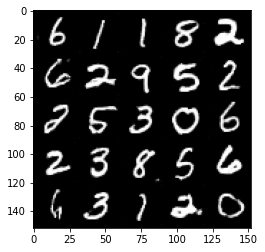

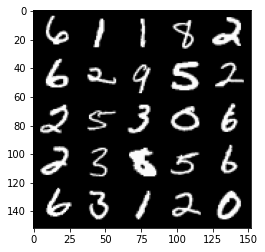

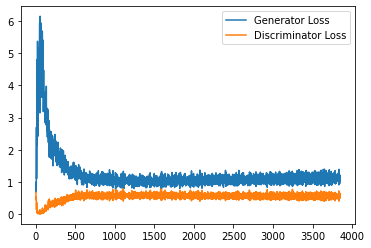

Step 77500: Generator loss: 1.1147714422941208, discriminator loss: 0.5587290897965431


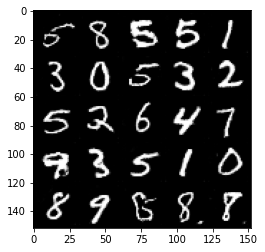

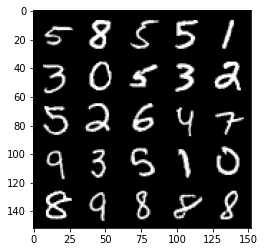

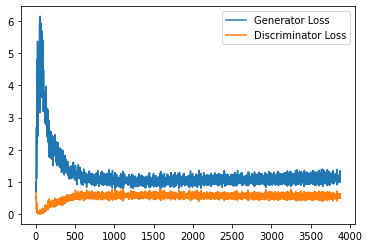

Step 78000: Generator loss: 1.1157290016412735, discriminator loss: 0.5657102613449096


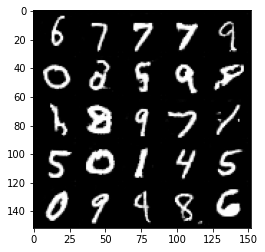

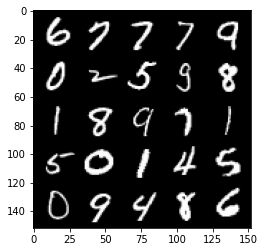

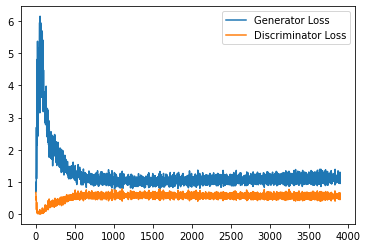

Step 78500: Generator loss: 1.1020290604829788, discriminator loss: 0.5561666068434715


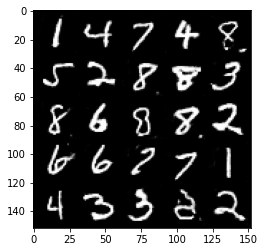

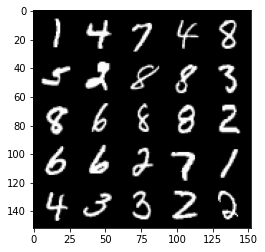

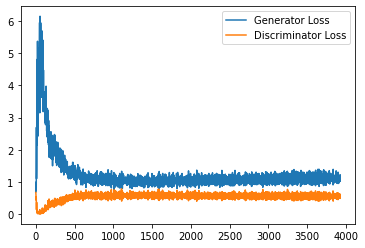

Step 79000: Generator loss: 1.092137311577797, discriminator loss: 0.5700514107346535


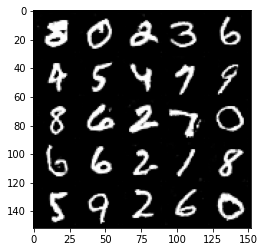

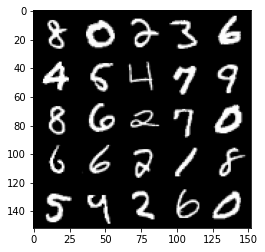

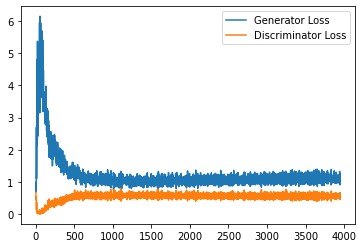

Step 79500: Generator loss: 1.0881359573602676, discriminator loss: 0.5636769985556602


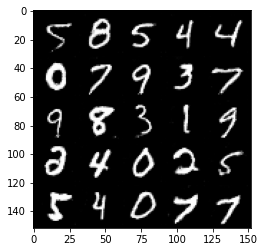

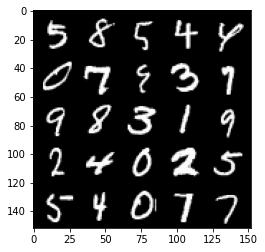

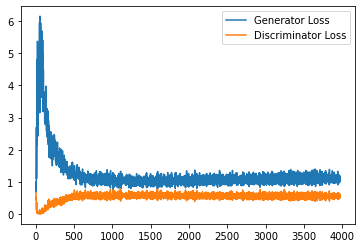

Step 80000: Generator loss: 1.1044610468149185, discriminator loss: 0.5725218356251717


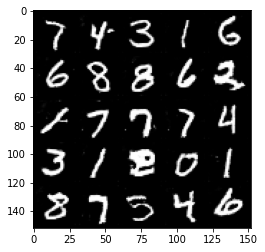

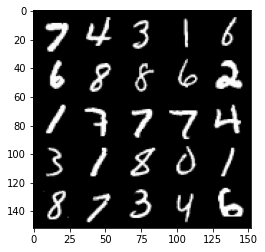

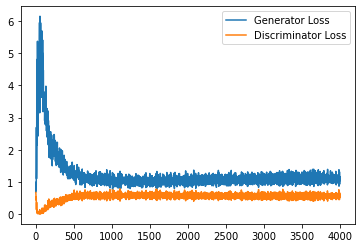

Step 80500: Generator loss: 1.120823894739151, discriminator loss: 0.5655978690385819


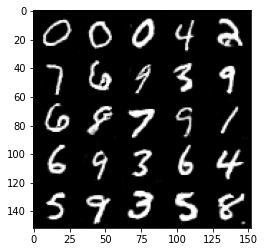

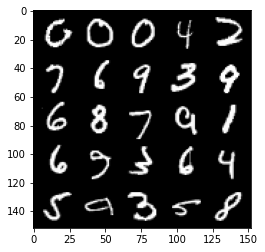

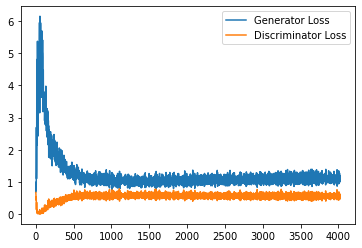

Step 81000: Generator loss: 1.087495840549469, discriminator loss: 0.5714117912650108


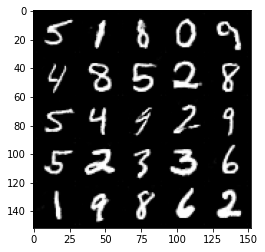

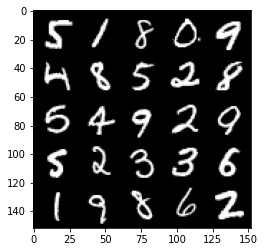

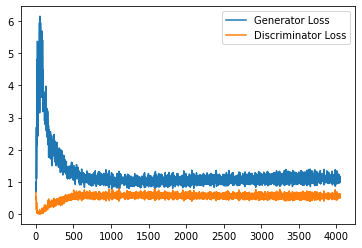

Step 81500: Generator loss: 1.1000841575860978, discriminator loss: 0.5716929565668106


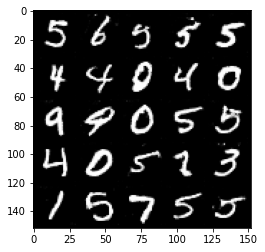

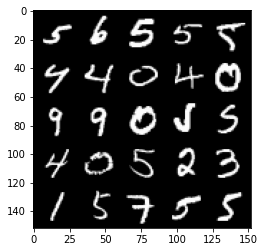

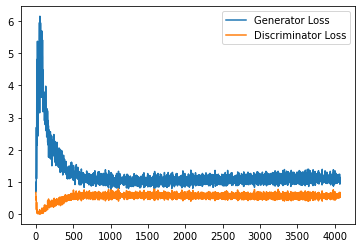

Step 82000: Generator loss: 1.0890473663806914, discriminator loss: 0.569437088906765


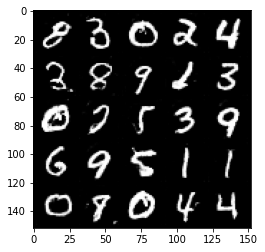

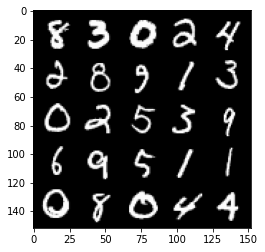

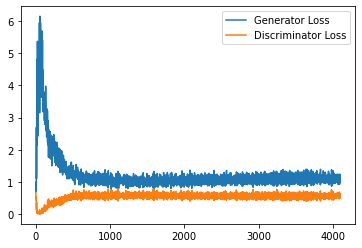

Step 82500: Generator loss: 1.0908513499498367, discriminator loss: 0.5783649929761887


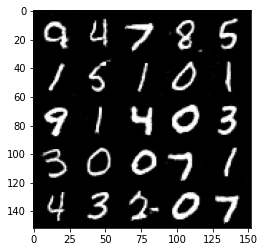

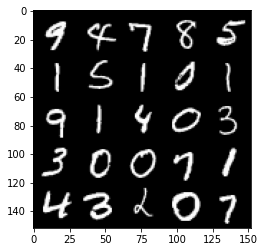

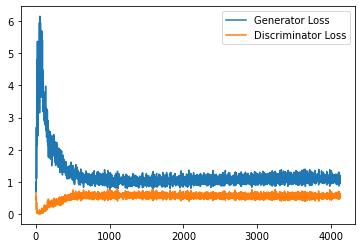

Step 83000: Generator loss: 1.10608502471447, discriminator loss: 0.5685595893859863


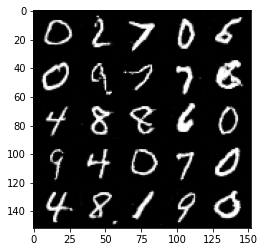

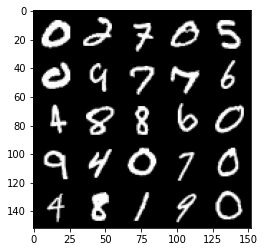

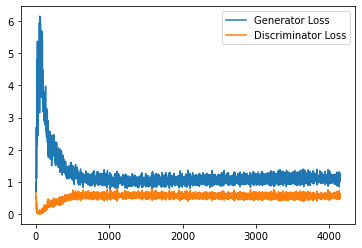

Step 83500: Generator loss: 1.0897921755313873, discriminator loss: 0.5709849933385849


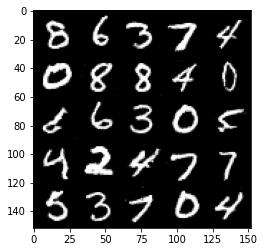

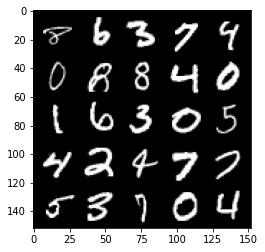

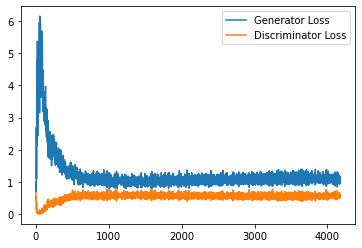

Step 84000: Generator loss: 1.1063617849349976, discriminator loss: 0.5698608560562134


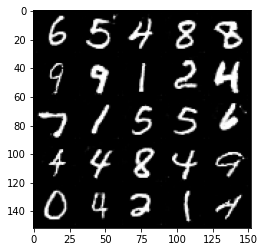

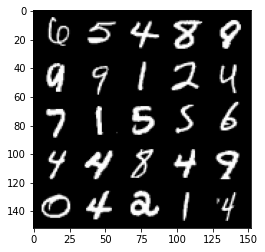

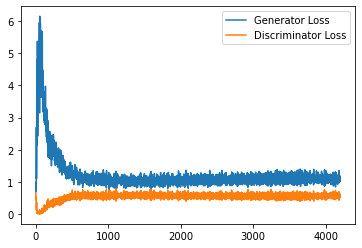

Step 84500: Generator loss: 1.090197288274765, discriminator loss: 0.5826937174797058


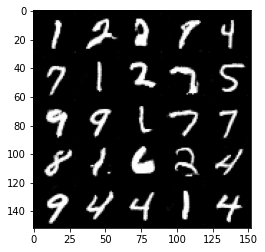

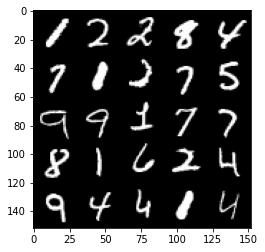

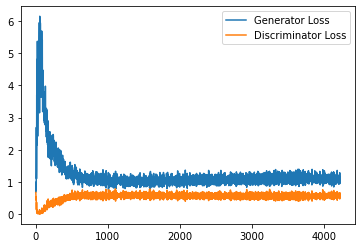

Step 85000: Generator loss: 1.082544161438942, discriminator loss: 0.5715596210360527


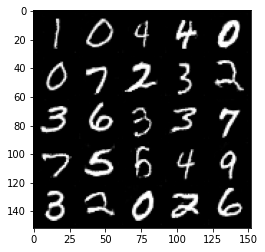

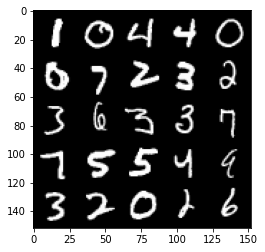

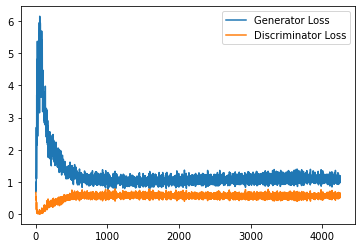

Step 85500: Generator loss: 1.105679947733879, discriminator loss: 0.569743545293808


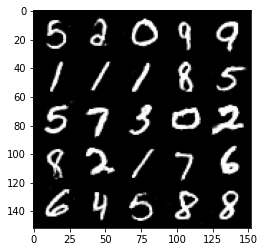

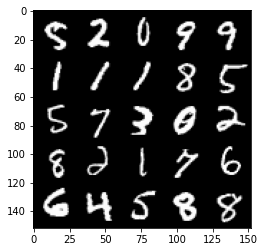

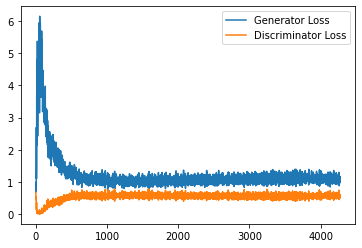

Step 86000: Generator loss: 1.0719842672348023, discriminator loss: 0.5748674956560135


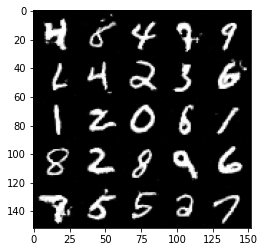

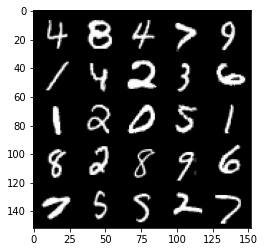

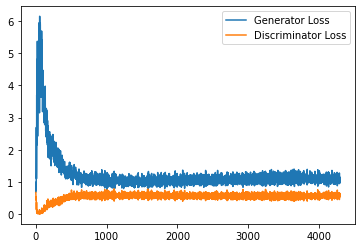

Step 86500: Generator loss: 1.095226108789444, discriminator loss: 0.5705625693202019


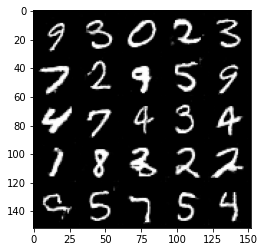

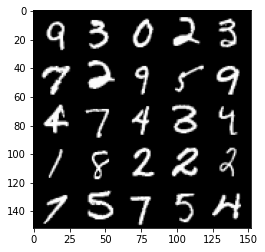

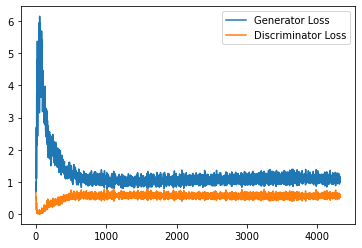

Step 87000: Generator loss: 1.0654127020835877, discriminator loss: 0.5829385984539985


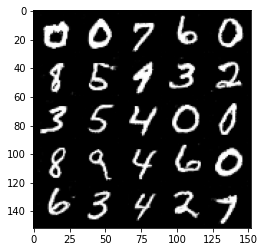

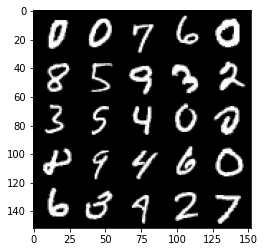

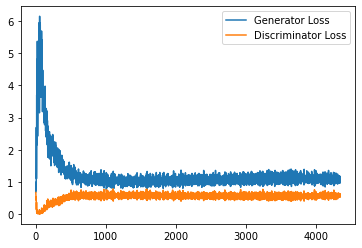

Step 87500: Generator loss: 1.0850930491685866, discriminator loss: 0.5757151336073876


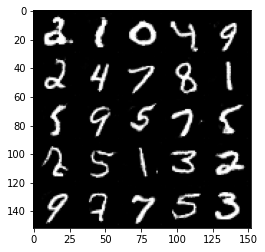

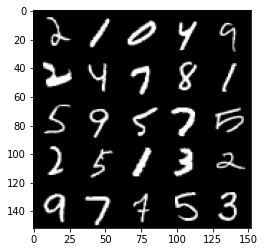

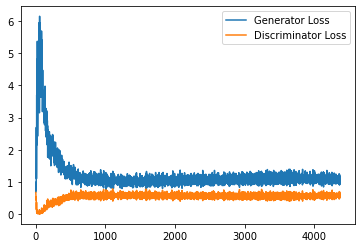

Step 88000: Generator loss: 1.0660705912113189, discriminator loss: 0.5857175127267837


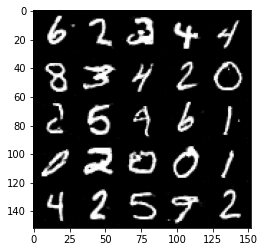

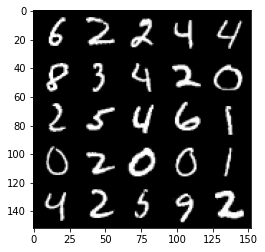

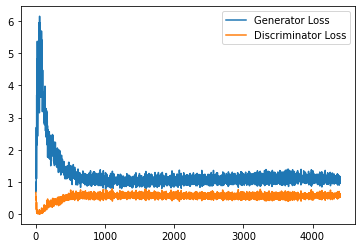

Step 88500: Generator loss: 1.0634801050424576, discriminator loss: 0.5823116016387939


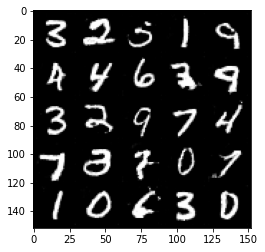

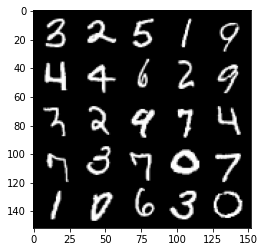

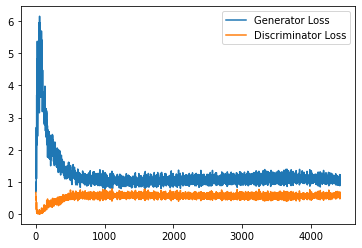

Step 89000: Generator loss: 1.0772911531925202, discriminator loss: 0.5789397787451744


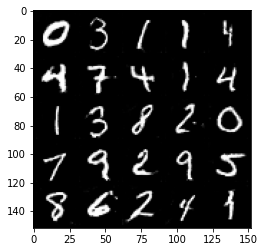

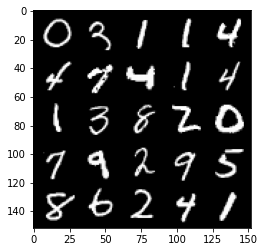

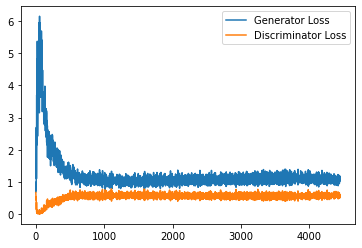

Step 89500: Generator loss: 1.0594140731096269, discriminator loss: 0.584419061422348


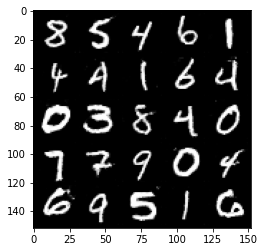

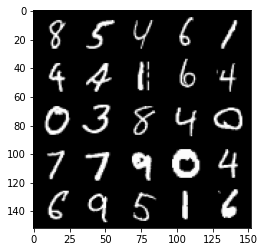

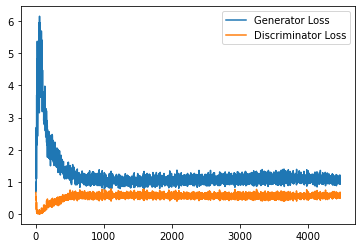

Step 90000: Generator loss: 1.0580816824436188, discriminator loss: 0.588285758793354


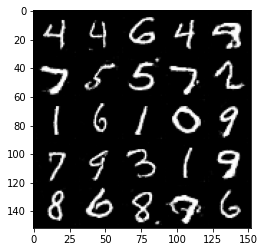

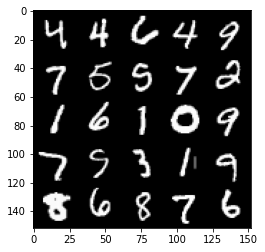

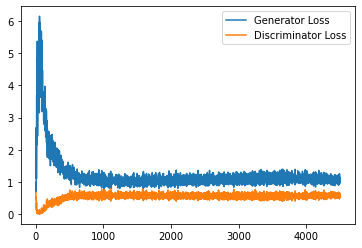

Step 90500: Generator loss: 1.0823920496702195, discriminator loss: 0.5855351982712745


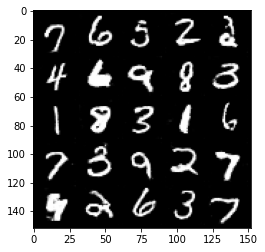

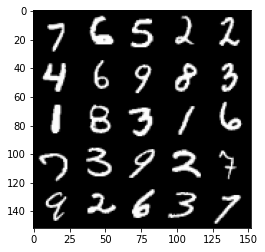

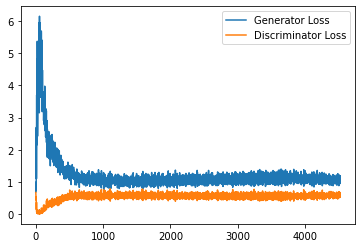

Step 91000: Generator loss: 1.0795782212018967, discriminator loss: 0.5819384759068489


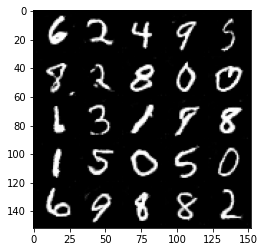

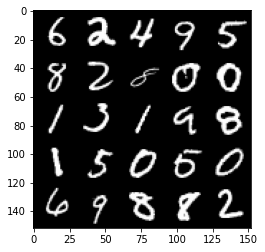

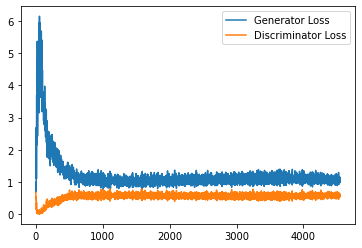

Step 91500: Generator loss: 1.0671994775533675, discriminator loss: 0.5848750709295273


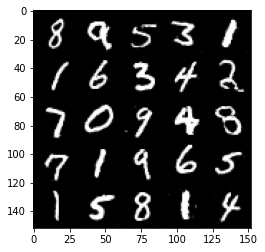

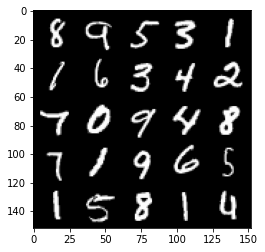

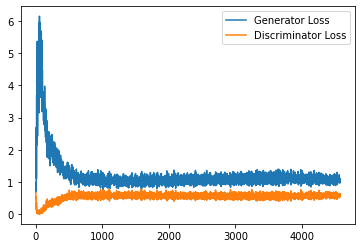

Step 92000: Generator loss: 1.065655101776123, discriminator loss: 0.5802849862575531


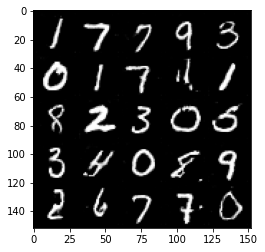

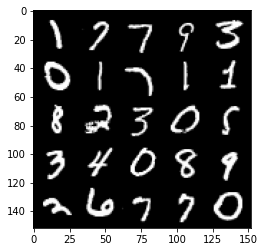

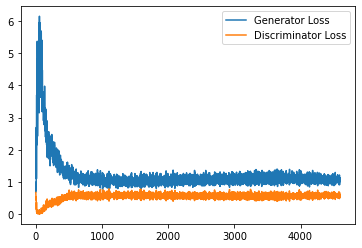

Step 92500: Generator loss: 1.073733260154724, discriminator loss: 0.5882395592927933


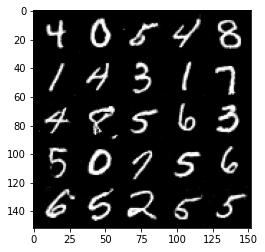

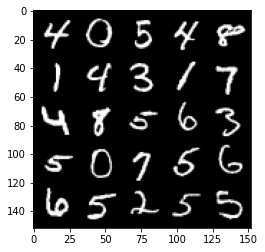

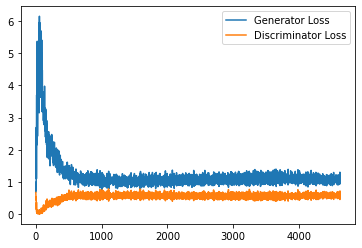

Step 93000: Generator loss: 1.064963134765625, discriminator loss: 0.58429458630085


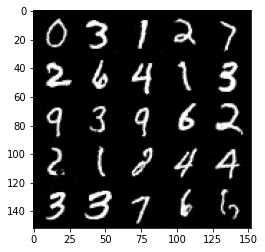

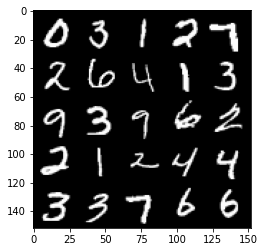

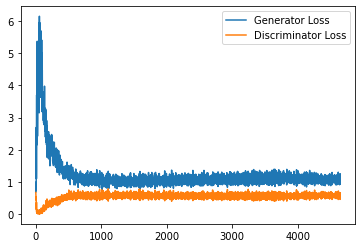

Step 93500: Generator loss: 1.0812879256010055, discriminator loss: 0.5862708745598793


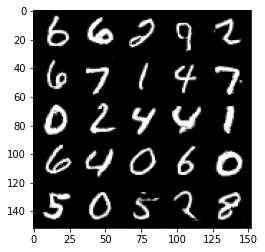

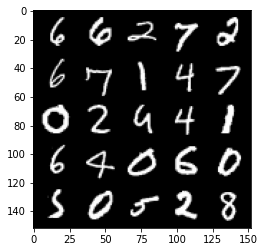

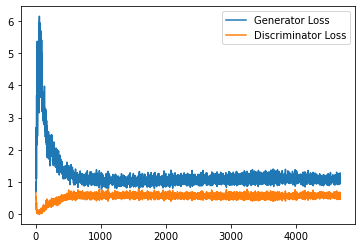

In [14]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise,one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake,image_one_hot_labels)
        real_image_and_labels = combine_vectors(real,image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels)
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [15]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

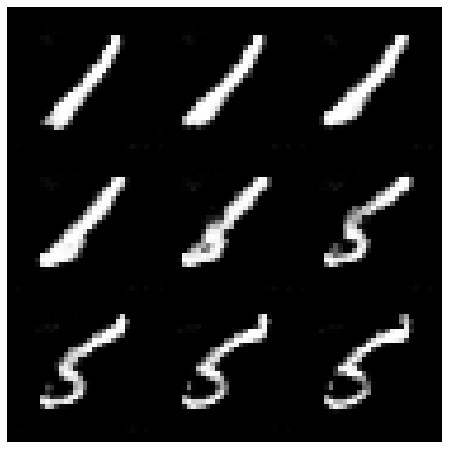

In [16]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

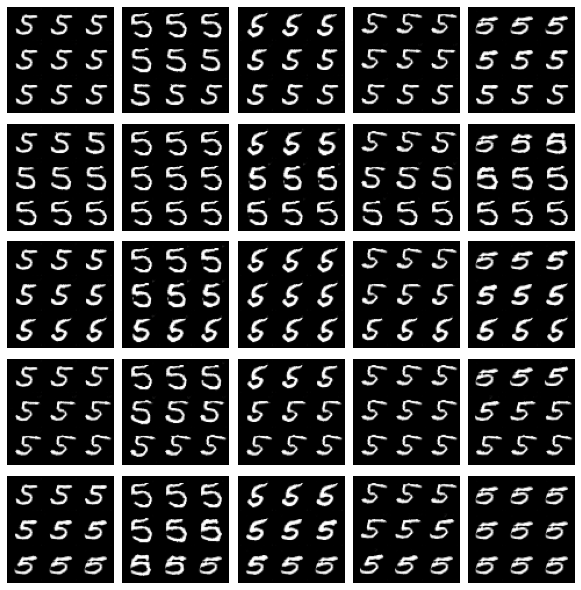

In [17]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()